In [1]:
#Kütüphaneler
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sbn


In [2]:
#arac bilgi verileri

df_araba=pd.read_csv("arac_ilanlari.csv")
print(df_araba)

           ilan_id                                       ilan_basligi  \
0       1080850207  DEĞİŞENSİZ YENİ MUAYENELİ RENAULT MEGANE FUL D...   
1       1101850722           KAZA,BOYA,DEĞİŞEN,TRAMER YOK. 80.000 km.   
2       1101855061                 HATASIZ AYARINDA MASRAFSIZ AUDİ A3   
3       1101851921  2020/A3 35 1.5 TFSİ/150 DESIGN+STRONIC PKT-SUN...   
4       1090594643                                         2015 MODEL   
...            ...                                                ...   
556751  1101751328                              Sahibinden Temiz Polo   
556752  1101528910                          SAHİBİNDEN TEMİZ A3 sedan   
556753  1101865698                                         2015 MODEL   
556754  1101865188          *MK AUTO*DAN BOYASIZ EDC JANZUMAN MEGAN 4   
556755  1101864410        OTOMATİK HASAR KAYITSIZ DEĞİŞENSİZ DÜŞÜK KM   

            fiyat fiyat_kuru                 ilan_tarihi  \
0        830000.0         TL  2023-05-26 09:23:29.000000   
1  

In [3]:
print(df_araba.isnull().sum())

ilan_id             0
ilan_basligi        0
fiyat               0
fiyat_kuru          0
ilan_tarihi         0
ilan_kategorisi     0
arac_tagleri        0
ilan_konumu         0
arac_ozellikleri    0
dtype: int64


In [4]:
print(df_araba.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 556756 entries, 0 to 556755
Data columns (total 9 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   ilan_id           556756 non-null  int64  
 1   ilan_basligi      556756 non-null  object 
 2   fiyat             556756 non-null  float64
 3   fiyat_kuru        556756 non-null  object 
 4   ilan_tarihi       556756 non-null  object 
 5   ilan_kategorisi   556756 non-null  object 
 6   arac_tagleri      556756 non-null  object 
 7   ilan_konumu       556756 non-null  object 
 8   arac_ozellikleri  556756 non-null  object 
dtypes: float64(1), int64(1), object(7)
memory usage: 38.2+ MB
None


In [5]:
print(df_araba.describe())

            ilan_id         fiyat
count  5.567560e+05  5.567560e+05
mean   1.088248e+09  8.081474e+05
std    3.167714e+07  1.101140e+07
min    5.523152e+08  1.000000e+00
25%    1.069335e+09  3.550000e+05
50%    1.093235e+09  5.550000e+05
75%    1.112327e+09  8.100000e+05
max    1.131802e+09  1.480000e+09


In [6]:
import re

df_araba['Kilometre'] = ""  

sayac = 0
for indeks, ozellikler in enumerate(df_araba["arac_ozellikleri"]):
    ozellikler_liste = ozellikler.strip("[]").split(", ")  
    ilk_eleman = ozellikler_liste[0].strip("'")
    km_degeri = re.sub(r'\D', '', ilk_eleman)  
    df_araba.at[indeks, 'Kilometre'] = km_degeri
    sayac += 1

print("Toplam işlenen satır sayısı:", sayac)
print(df_araba)

Toplam işlenen satır sayısı: 556756
           ilan_id                                       ilan_basligi  \
0       1080850207  DEĞİŞENSİZ YENİ MUAYENELİ RENAULT MEGANE FUL D...   
1       1101850722           KAZA,BOYA,DEĞİŞEN,TRAMER YOK. 80.000 km.   
2       1101855061                 HATASIZ AYARINDA MASRAFSIZ AUDİ A3   
3       1101851921  2020/A3 35 1.5 TFSİ/150 DESIGN+STRONIC PKT-SUN...   
4       1090594643                                         2015 MODEL   
...            ...                                                ...   
556751  1101751328                              Sahibinden Temiz Polo   
556752  1101528910                          SAHİBİNDEN TEMİZ A3 sedan   
556753  1101865698                                         2015 MODEL   
556754  1101865188          *MK AUTO*DAN BOYASIZ EDC JANZUMAN MEGAN 4   
556755  1101864410        OTOMATİK HASAR KAYITSIZ DEĞİŞENSİZ DÜŞÜK KM   

            fiyat fiyat_kuru                 ilan_tarihi  \
0        830000.0         T

In [7]:
arac_ozellikleri_listesi = df_araba["arac_ozellikleri"]
arac_ozellikleri_dizi = arac_ozellikleri_listesi.apply(eval)
print(arac_ozellikleri_dizi)

0         [143.000 km, 2016 model, Dizel, 110 hp, Otomatik]
1          [80.000 km, 2017 model, Dizel, 110 hp, Otomatik]
2         [177.000 km, 2011 model, Benzin & LPG, 102 hp,...
3         [33.000 km, 2020 model, Benzin, 150 hp, Otomatik]
4            [125.000 km, 2015 model, Dizel, 75 hp, Manuel]
                                ...                        
556751     [57.000 km, 2016 model, Benzin, 90 hp, Otomatik]
556752     [8.500 km, 2022 model, Hybrid, 150 hp, Otomatik]
556753       [205.000 km, 2015 model, Dizel, 75 hp, Manuel]
556754     [22.000 km, 2020 model, Dizel, 115 hp, Otomatik]
556755    [181.000 km, 2007 model, Benzin & LPG, 102 hp,...
Name: arac_ozellikleri, Length: 556756, dtype: object


In [8]:
# DataFrame oluşturma

df = pd.DataFrame(arac_ozellikleri_dizi, columns=["Column_1", "Column_2", "Column_3", "motor_gucu", "Column_5"])
df_araba['motor_gucu'] = df['motor_gucu']

In [9]:
# motor gücü değerlerinin elde edilmesi

for index, liste in enumerate(arac_ozellikleri_dizi):
    try:
        eleman = liste[3]                                              # Listenin dördüncü elemanı
        df_araba.loc[index, 'motor_gucu'] = eleman             
    except IndexError:
        df_araba.loc[index, 'motor_gucu'] = 'x'                        # Eğer değer eklenemezse 'x' ekle

print(df_araba)

           ilan_id                                       ilan_basligi  \
0       1080850207  DEĞİŞENSİZ YENİ MUAYENELİ RENAULT MEGANE FUL D...   
1       1101850722           KAZA,BOYA,DEĞİŞEN,TRAMER YOK. 80.000 km.   
2       1101855061                 HATASIZ AYARINDA MASRAFSIZ AUDİ A3   
3       1101851921  2020/A3 35 1.5 TFSİ/150 DESIGN+STRONIC PKT-SUN...   
4       1090594643                                         2015 MODEL   
...            ...                                                ...   
556751  1101751328                              Sahibinden Temiz Polo   
556752  1101528910                          SAHİBİNDEN TEMİZ A3 sedan   
556753  1101865698                                         2015 MODEL   
556754  1101865188          *MK AUTO*DAN BOYASIZ EDC JANZUMAN MEGAN 4   
556755  1101864410        OTOMATİK HASAR KAYITSIZ DEĞİŞENSİZ DÜŞÜK KM   

            fiyat fiyat_kuru                 ilan_tarihi  \
0        830000.0         TL  2023-05-26 09:23:29.000000   
1  

In [10]:
df_araba['motor_gucu'] = df_araba['motor_gucu'].str.replace(' hp', '', regex=False)

In [11]:
print(df_araba["motor_gucu"].head(57))

0              110
1              110
2              102
3              150
4               75
5              110
6     101 - 125 HP
7              110
8              115
9              140
10              75
11             140
12             106
13             110
14             140
15              98
16             105
17             140
18     76 - 100 HP
19              85
20             100
21             102
22             110
23             115
24              85
25              85
26             140
27              86
28              75
29              90
30             110
31              70
32              95
33             110
34             140
35             110
36             110
37              90
38             110
39             110
40             140
41              98
42             110
43              90
44             115
45              90
46              60
47              90
48             110
49             110
50              90
51              75
52          

In [12]:
# DataFrame oluşturma
df = pd.DataFrame(arac_ozellikleri_dizi, columns=["Column_1", "Column_2", "Yakit", "motor_gucu", "Column_5"])

# "yakıt" sütununu eklemek için
df_araba['Yakit'] = df['Yakit']

In [13]:
yakit_turleri = []
for liste in arac_ozellikleri_dizi:
    try:
        yakit = liste[2] if liste[2] is not None else 'x'         # 'Yakit' bilgisinin olduğu indeks veya 'x' yaz
        yakit_turleri.append(yakit)                                
    except IndexError:
        yakit_turleri.append('x')                                 # Eğer indeks hatası alınırsa 'x' ekle
print(yakit_turleri)


['Dizel', 'Dizel', 'Benzin & LPG', 'Benzin', 'Dizel', 'Dizel', 'Dizel', 'Dizel', 'Benzin & LPG', 'Benzin', 'Benzin & LPG', 'Benzin', 'Dizel', 'Dizel', 'Benzin', 'Benzin & LPG', 'Dizel', 'Benzin', 'Benzin', 'Benzin', 'Benzin', 'Benzin', 'Dizel', 'Benzin & LPG', 'Benzin', 'Dizel', 'Benzin', 'Dizel', 'Benzin & LPG', 'Benzin', 'Dizel', 'Benzin', 'Benzin', 'Dizel', 'Benzin', 'Dizel', 'Dizel', 'Dizel', 'Dizel', 'Dizel', 'Benzin', 'Benzin & LPG', 'Dizel', 'Benzin', 'Benzin & LPG', 'Dizel', 'Benzin & LPG', 'Dizel', 'Dizel', 'Dizel', 'Dizel', 'Benzin & LPG', 'Dizel', 'Dizel', 'Dizel', 'Dizel', 'Dizel', 'Dizel', 'Benzin & LPG', 'Dizel', 'Benzin & LPG', 'Dizel', 'Dizel', 'Benzin', 'Dizel', 'Benzin & LPG', 'Benzin', 'Dizel', 'Benzin', 'Dizel', 'Dizel', 'Benzin', 'Benzin & LPG', 'Benzin', 'Benzin', 'Dizel', 'Benzin', 'Benzin & LPG', 'Dizel', 'Dizel', 'Benzin', 'Dizel', 'Benzin', 'Dizel', 'Dizel', 'Benzin & LPG', 'Dizel', 'Benzin', 'Benzin', 'Benzin', 'Benzin & LPG', 'Dizel', 'Dizel', 'Benzin', 'Diz

In [14]:
df_araba['Yakit'] = yakit_turleri

In [15]:
print(df_araba["Yakit"])

0                Dizel
1                Dizel
2         Benzin & LPG
3               Benzin
4                Dizel
              ...     
556751          Benzin
556752          Hybrid
556753           Dizel
556754           Dizel
556755    Benzin & LPG
Name: Yakit, Length: 556756, dtype: object


In [16]:
print(df_araba.columns)

Index(['ilan_id', 'ilan_basligi', 'fiyat', 'fiyat_kuru', 'ilan_tarihi',
       'ilan_kategorisi', 'arac_tagleri', 'ilan_konumu', 'arac_ozellikleri',
       'Kilometre', 'motor_gucu', 'Yakit'],
      dtype='object')


In [17]:
# İki değer içeren motor gücü indekslerinin kontrolü

iki_deger_iceren_indeksler = []

for index, deger in enumerate(df_araba['motor_gucu']):
    if '-' in str(deger):
        iki_deger_iceren_indeksler.append(index)

# İki değer içeren öğelerin sayısını ve indekslerini yazdıralım
print("Toplam iki değer içeren öğe sayısı:", len(iki_deger_iceren_indeksler))
print("İki değer içeren öğelerin indeksleri:", iki_deger_iceren_indeksler)

Toplam iki değer içeren öğe sayısı: 24280
İki değer içeren öğelerin indeksleri: [6, 18, 54, 56, 72, 97, 111, 139, 214, 225, 268, 273, 303, 420, 481, 501, 521, 599, 647, 667, 670, 671, 687, 688, 706, 753, 818, 827, 862, 885, 887, 922, 987, 1049, 1071, 1087, 1098, 1146, 1179, 1194, 1242, 1257, 1304, 1339, 1377, 1390, 1394, 1434, 1455, 1473, 1480, 1531, 1535, 1539, 1574, 1588, 1592, 1597, 1612, 1633, 1646, 1724, 1725, 1771, 1785, 1842, 1891, 1903, 1905, 1949, 1953, 1957, 1960, 1965, 1995, 2042, 2044, 2054, 2063, 2068, 2212, 2217, 2222, 2231, 2265, 2336, 2339, 2342, 2353, 2370, 2387, 2411, 2434, 2449, 2454, 2475, 2541, 2557, 2622, 2674, 2692, 2717, 2767, 2785, 2788, 2792, 2814, 2821, 2829, 2890, 2920, 2925, 2946, 2949, 2975, 3024, 3050, 3095, 3118, 3242, 3267, 3303, 3321, 3352, 3355, 3380, 3387, 3488, 3494, 3579, 3610, 3615, 3645, 3679, 3710, 3728, 3752, 3767, 3796, 3822, 3837, 3843, 3857, 3871, 3887, 3901, 3946, 3970, 3976, 4011, 4014, 4024, 4083, 4120, 4147, 4188, 4198, 4211, 4224, 4238,

In [18]:
print(df_araba.columns)

Index(['ilan_id', 'ilan_basligi', 'fiyat', 'fiyat_kuru', 'ilan_tarihi',
       'ilan_kategorisi', 'arac_tagleri', 'ilan_konumu', 'arac_ozellikleri',
       'Kilometre', 'motor_gucu', 'Yakit'],
      dtype='object')


In [19]:
import ast
sayac = 0

for satir in df_araba.index:                                      
    satir_string = df_araba["arac_tagleri"][satir]
    satir_sozluk = ast.literal_eval(satir_string)
    
    marka = satir_sozluk.get('Marka', 'Bilinmeyen Marka')
    seri = satir_sozluk.get('Seri', 'Bilinmeyen Seri')
    df_araba.at[satir, 'Marka'] = marka
    df_araba.at[satir, 'Seri'] = seri
    
    print(marka, seri)
    sayac += 1

print("Toplam işlenen satır sayısı:", sayac)

Renault Megane
Renault Megane
Audi A3
Audi A3
Volkswagen Polo
Renault Megane
Renault Megane
Renault Megane
Renault Megane
Opel Astra
Volkswagen Polo
Renault Megane
Renault Megane
Audi A3
Renault Megane
Renault Megane
Renault Megane
Renault Megane
Volkswagen Polo
Volkswagen Polo
Volkswagen Polo
Audi A3
Renault Megane
Renault Megane
Volkswagen Polo
Renault Megane
Renault Megane
Renault Megane
Volkswagen Polo
Volkswagen Polo
Renault Megane
Volkswagen Polo
Volkswagen Polo
Renault Megane
Renault Megane
Renault Megane
Renault Megane
Volkswagen Polo
Renault Megane
Audi A3
Opel Astra
Renault Megane
Audi A3
Volkswagen Polo
Renault Megane
Volkswagen Polo
Volkswagen Polo
Volkswagen Polo
Renault Megane
Audi A3
Volkswagen Polo
Volkswagen Polo
Audi A3
Renault Megane
Volkswagen Polo
Renault Megane
Audi A3
Volkswagen Polo
Renault Megane
Renault Megane
Renault Megane
Volkswagen Polo
Volkswagen Polo
Renault Megane
Volkswagen Polo
Renault Megane
Audi A3
Renault Megane
Renault Megane
Renault Megane
Volksw

In [20]:
print(df_araba["Marka"])

0            Renault
1            Renault
2               Audi
3               Audi
4         Volkswagen
             ...    
556751    Volkswagen
556752          Audi
556753    Volkswagen
556754       Renault
556755          Audi
Name: Marka, Length: 556756, dtype: object


In [21]:
#marka sayıları
print(df_araba["Seri"].value_counts())

Megane             271120
Polo               184385
A3                  86105
Astra                7824
C3 AirCross          5923
D-Max                1392
A5                      4
Bilinmeyen Seri         3
Name: Seri, dtype: int64


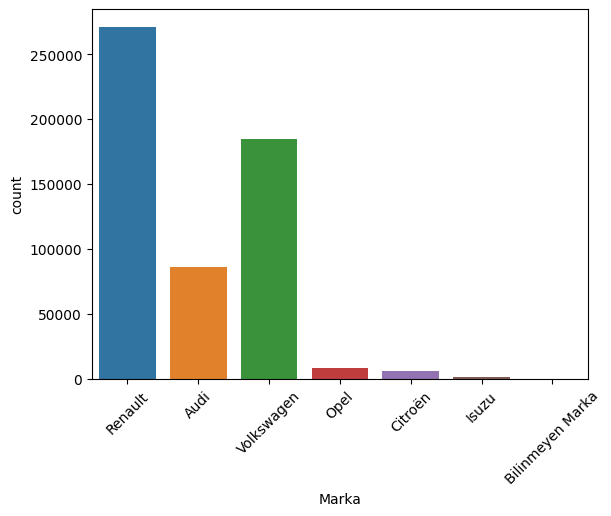

In [22]:
#marka grafiği
import seaborn as sns
import matplotlib.pyplot as plt

sns.countplot(data=df_araba, x='Marka')
plt.xticks(rotation=45)
plt.show()

In [23]:
#farklı marka isimleri
print(df_araba["Marka"].unique())

['Renault' 'Audi' 'Volkswagen' 'Opel' 'Citroën' 'Isuzu' 'Bilinmeyen Marka']


In [24]:
marka_frekanslari = df_araba['Marka'].value_counts()
print(marka_frekanslari)

Renault             271120
Volkswagen          184385
Audi                 86109
Opel                  7824
Citroën               5923
Isuzu                 1392
Bilinmeyen Marka         3
Name: Marka, dtype: int64


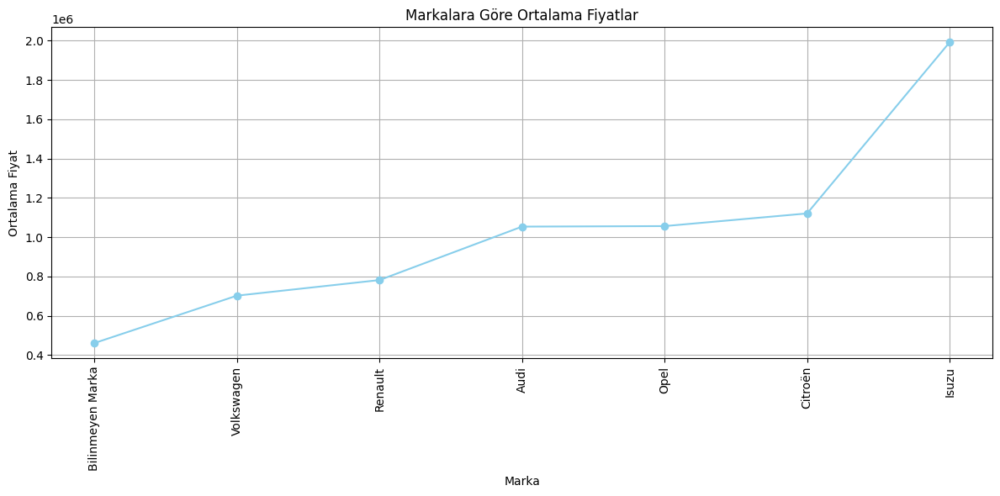

In [25]:
#markalara göre ortalama fiyat grafiği
import matplotlib.pyplot as plt

marka_fiyat_ortalamalari = df_araba.groupby('Marka')['fiyat'].mean().sort_values()
plt.figure(figsize=(12, 6))
marka_fiyat_ortalamalari.plot(kind='line', marker='o', color='skyblue')
plt.title('Markalara Göre Ortalama Fiyatlar')
plt.xlabel('Marka')
plt.ylabel('Ortalama Fiyat')
plt.xticks(rotation=90)
plt.grid(True)
plt.tight_layout()
plt.show()



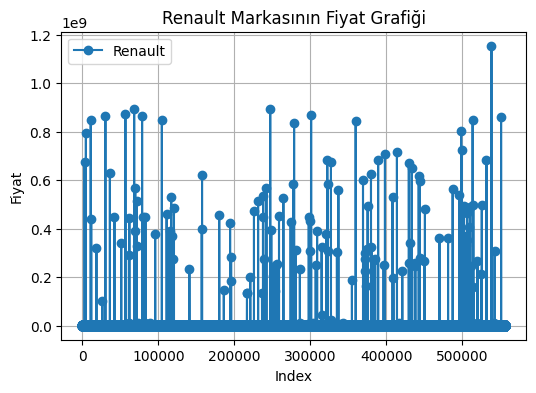

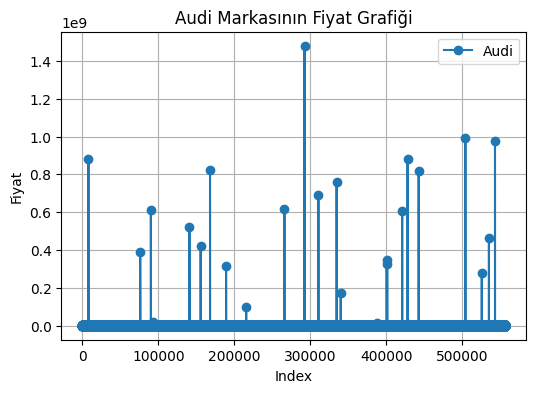

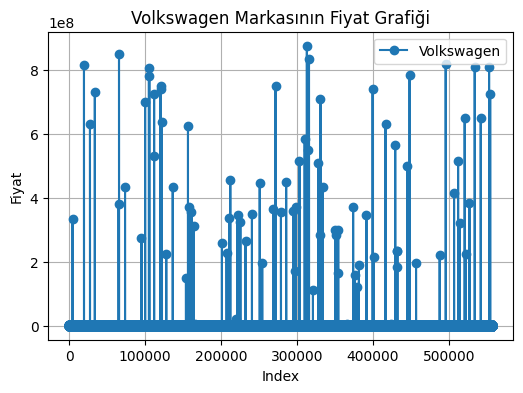

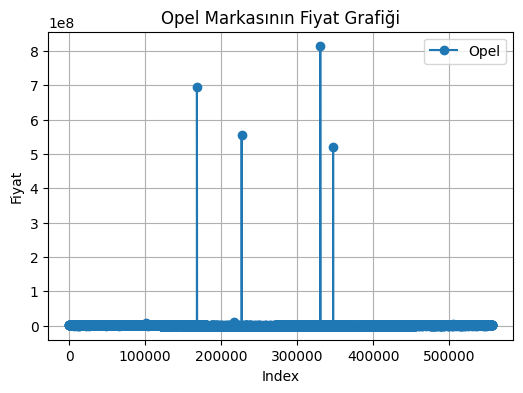

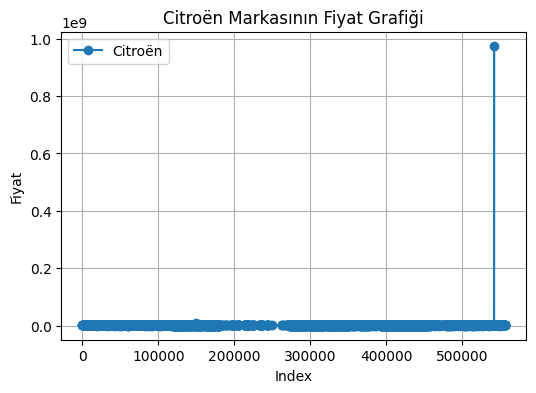

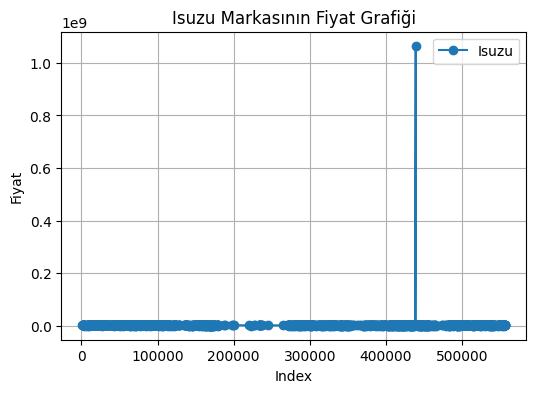

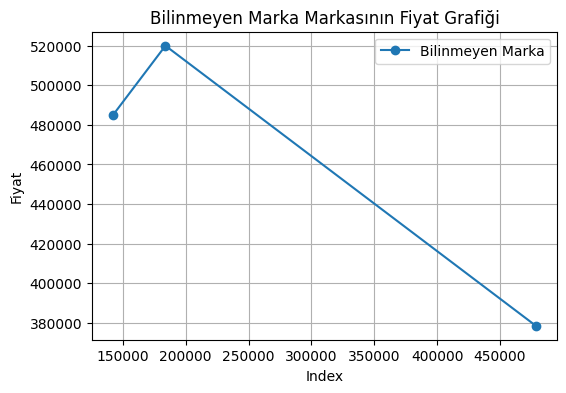

In [26]:
import matplotlib.pyplot as plt

# Her bir marka için ayrı grafik oluşturalım
for marka in df_araba['Marka'].unique():
    marka_verileri = df_araba[df_araba['Marka'] == marka]
    
    plt.figure(figsize=(6, 4))
    plt.plot(marka_verileri['fiyat'], label=marka, marker='o')
    plt.title(f'{marka} Markasının Fiyat Grafiği')
    plt.xlabel('Index')
    plt.ylabel('Fiyat')
    plt.legend()
    plt.grid(True)
    plt.show()


In [27]:
sutun = df_araba["arac_ozellikleri"]
bolunmus_sutun = sutun.str.split("'", expand=True)        #bilgileri ayırmak icin ' isaretinde böl
model=bolunmus_sutun[3]
model_sutun = model.str.split(' ', expand=True)
arac_model=model_sutun[0]                                 #ARACLARIN MODEL YILLARI

print(arac_model)

0         2016
1         2017
2         2011
3         2020
4         2015
          ... 
556751    2016
556752    2022
556753    2015
556754    2020
556755    2007
Name: 0, Length: 556756, dtype: object


In [28]:
df_araba['Model_Yili'] = arac_model

In [29]:
print(df_araba["Model_Yili"])

0         2016
1         2017
2         2011
3         2020
4         2015
          ... 
556751    2016
556752    2022
556753    2015
556754    2020
556755    2007
Name: Model_Yili, Length: 556756, dtype: object


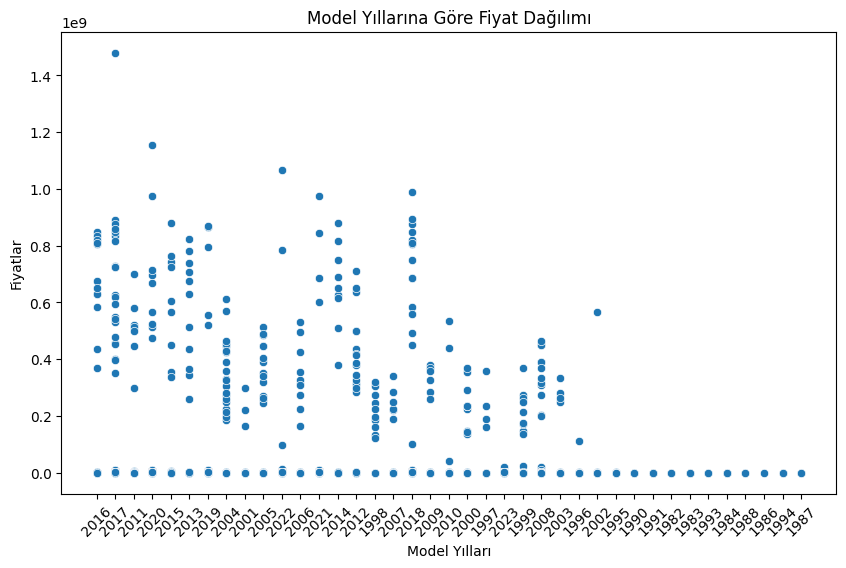

In [30]:
#model yıllarına göre fiyat grafiği

plt.figure(figsize=(10, 6))
sns.scatterplot(x=df_araba["Model_Yili"], y=df_araba['fiyat'])
plt.xlabel('Model Yılları')
plt.ylabel('Fiyatlar')
plt.title('Model Yıllarına Göre Fiyat Dağılımı')
plt.xticks(rotation=45)
plt.show()

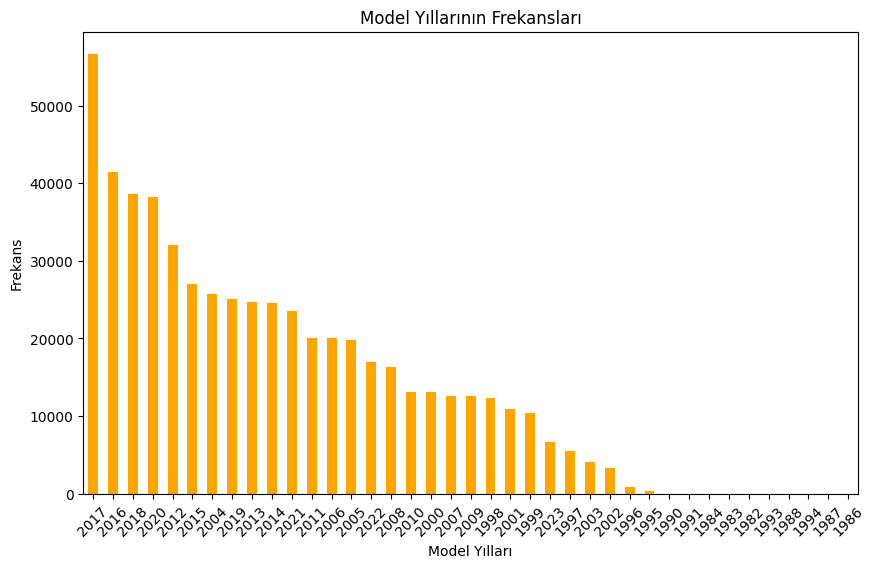

In [31]:
# Model yıllarına göre ilan sıklığı

frekanslar = df_araba["Model_Yili"].value_counts()
plt.figure(figsize=(10, 6))
frekanslar.plot(kind='bar', color='orange')
plt.xlabel('Model Yılları')
plt.ylabel('Frekans')
plt.title('Model Yıllarının Frekansları')
plt.xticks(rotation=45)  
plt.show()

In [32]:
print(df_araba["ilan_konumu"])

0             İstanbul, Ümraniye
1                   İzmir, Konak
2                  Adana, Seyhan
3              İstanbul, Sarıyer
4         Kırklareli, Lüleburgaz
                   ...          
556751        İstanbul, Çekmeköy
556752      İstanbul, Beylikdüzü
556753            Bitlis, Tatvan
556754               Ordu, Fatsa
556755           Aksaray, Merkez
Name: ilan_konumu, Length: 556756, dtype: object


In [33]:
#ilan konumlarından şehiri ayırmak
df_araba["Sehir"] = df_araba["ilan_konumu"].apply(lambda x: x.split(",")[0])

print(df_araba["Sehir"])

0           İstanbul
1              İzmir
2              Adana
3           İstanbul
4         Kırklareli
             ...    
556751      İstanbul
556752      İstanbul
556753        Bitlis
556754          Ordu
556755       Aksaray
Name: Sehir, Length: 556756, dtype: object


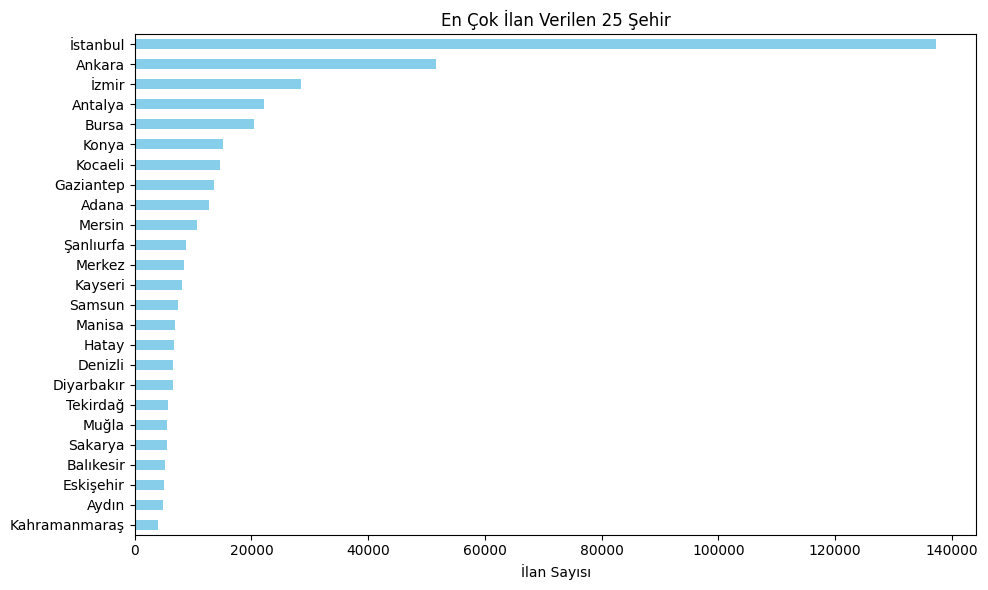

In [34]:
#en çok ilan verilen 25 şehir
import matplotlib.pyplot as plt

sehir_frekans = df_araba["Sehir"].value_counts()
en_cok_gorulen_sehirler = sehir_frekans.head(25)
plt.figure(figsize=(10, 6))
en_cok_gorulen_sehirler.plot(kind='barh', color='skyblue')
plt.xlabel('İlan Sayısı')
plt.title('En Çok İlan Verilen 25 Şehir')
plt.gca().invert_yaxis()  
plt.tight_layout()
plt.show()

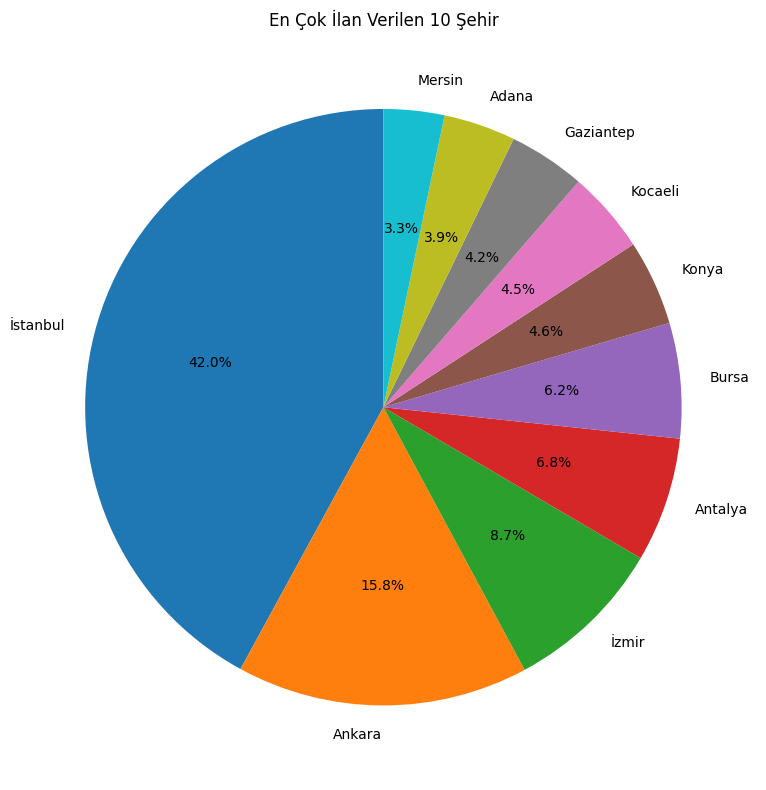

In [35]:
import matplotlib.pyplot as plt

# Şehirlerin frekansını al
sehir_frekans = df_araba["Sehir"].value_counts()

# Veri setinizdeki en çok görülen ilk 10 şehri alalım
en_cok_gorulen_sehirler = sehir_frekans.head(10)

# Pasta grafiği oluşturalım
plt.figure(figsize=(8, 8))
plt.pie(en_cok_gorulen_sehirler, labels=en_cok_gorulen_sehirler.index, autopct='%1.1f%%', startangle=90)
plt.title('En Çok İlan Verilen 10 Şehir')
plt.tight_layout()
plt.show()

In [36]:
#İLK 10 ŞEHİR
from tabulate import tabulate


sehirler_sayisi = df_araba["Sehir"].value_counts().reset_index()
sehirler_sayisi.columns = ['Şehir', 'İlan Sayısı']
ilk_10_sehir = sehirler_sayisi.head(10)
print(tabulate(ilk_10_sehir, headers='keys', tablefmt='fancy_grid'))

╒════╤═══════════╤═══════════════╕
│    │ Şehir     │   İlan Sayısı │
╞════╪═══════════╪═══════════════╡
│  0 │ İstanbul  │        137362 │
├────┼───────────┼───────────────┤
│  1 │ Ankara    │         51626 │
├────┼───────────┼───────────────┤
│  2 │ İzmir     │         28436 │
├────┼───────────┼───────────────┤
│  3 │ Antalya   │         22078 │
├────┼───────────┼───────────────┤
│  4 │ Bursa     │         20404 │
├────┼───────────┼───────────────┤
│  5 │ Konya     │         15107 │
├────┼───────────┼───────────────┤
│  6 │ Kocaeli   │         14573 │
├────┼───────────┼───────────────┤
│  7 │ Gaziantep │         13580 │
├────┼───────────┼───────────────┤
│  8 │ Adana     │         12752 │
├────┼───────────┼───────────────┤
│  9 │ Mersin    │         10752 │
╘════╧═══════════╧═══════════════╛


In [37]:
#İLANA KOYULMA TARİHLERİNİ ALMA

import pandas as pd

df_araba['tarih'] = pd.to_datetime(df_araba['ilan_tarihi']).dt.date
print(df_araba['tarih'])

0         2023-05-26
1         2023-05-26
2         2023-05-26
3         2023-05-26
4         2023-05-26
             ...    
556751    2023-05-26
556752    2023-05-26
556753    2023-05-26
556754    2023-05-26
556755    2023-05-26
Name: tarih, Length: 556756, dtype: object


In [38]:
#ilçeleri alma
df_araba['ilce'] = df_araba["ilan_konumu"].apply(lambda x: x.split(",")[-1].strip())

print(df_araba['ilce'])


0           Ümraniye
1              Konak
2             Seyhan
3            Sarıyer
4         Lüleburgaz
             ...    
556751      Çekmeköy
556752    Beylikdüzü
556753        Tatvan
556754         Fatsa
556755        Merkez
Name: ilce, Length: 556756, dtype: object


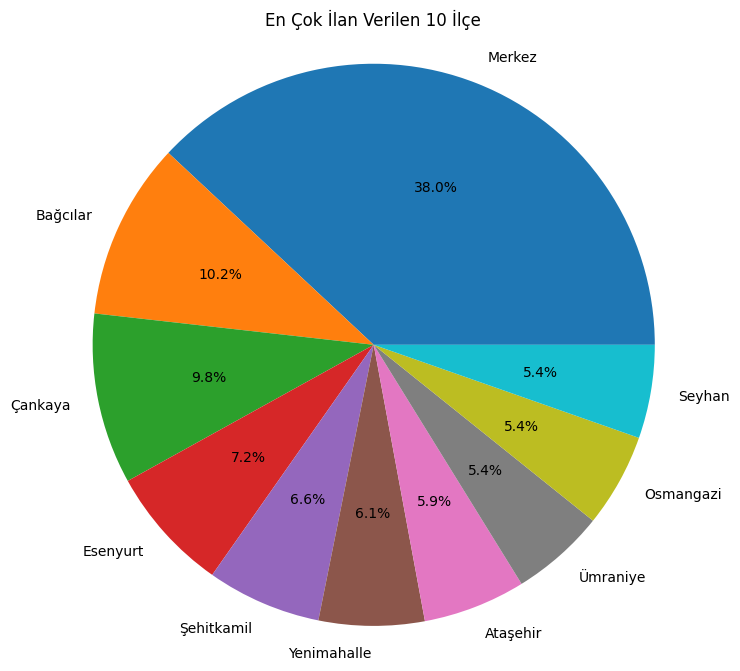

In [39]:
import matplotlib.pyplot as plt


ilce_counts = df_araba['ilce'].value_counts().head(10)
plt.figure(figsize=(8, 8))
plt.pie(ilce_counts, labels=ilce_counts.index, autopct='%1.1f%%')
plt.title('En Çok İlan Verilen 10 İlçe')
plt.axis('equal')  
plt.show()


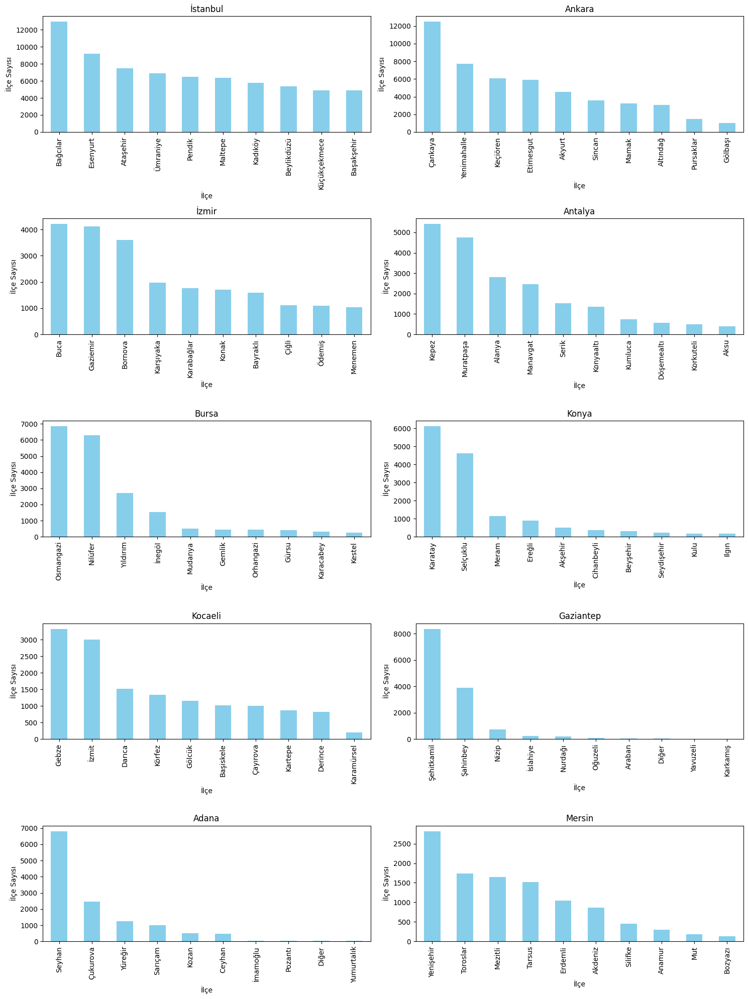

In [40]:
#en çok ilan verilen 10 şehrin, en çok ilan verilen 10 ilçesi
import matplotlib.pyplot as plt

top_sehirler = df_araba['Sehir'].value_counts().head(10).index.tolist()
fig, axs = plt.subplots(5, 2, figsize=(15, 20))  
for i, sehir in enumerate(top_sehirler):
    ilceler = df_araba[df_araba['Sehir'] == sehir]['ilce'].value_counts().head(10)
    ax = axs[i // 2, i % 2]  
    ilceler.plot(kind='bar', ax=ax, color='skyblue')
    ax.set_title(sehir)
    ax.set_ylabel('İlçe Sayısı')
    ax.set_xlabel('İlçe')
    plt.tight_layout()
plt.show()

In [41]:
######## VERİ AYIKLAMA

In [42]:
print(df_araba.columns)

Index(['ilan_id', 'ilan_basligi', 'fiyat', 'fiyat_kuru', 'ilan_tarihi',
       'ilan_kategorisi', 'arac_tagleri', 'ilan_konumu', 'arac_ozellikleri',
       'Kilometre', 'motor_gucu', 'Yakit', 'Marka', 'Seri', 'Model_Yili',
       'Sehir', 'tarih', 'ilce'],
      dtype='object')


In [43]:
print(len(df_araba)*0.01)

5567.56


In [44]:
# 'fiyat' sütununu kullanarak en yüksek fiyat değerlerine sahip olan satırları buluyoruz

en_yuksek_degerler = df_araba.nlargest(5567, 'fiyat')
print(en_yuksek_degerler)


           ilan_id                                       ilan_basligi  \
292538  1113050828                             Temiz hatasız düşük km   
538721  1100183989                   2020 Model Megane 1.3 TCE 140 HP   
439028  1076542659            SIFIRDAN FARKSIZ 3.000 km de-2022 MODEL   
504397  1097099973                            FULL ORJİNAL İHTİYAÇTAN   
542168  1119695542         HATASIZ BOYASIZ 2021 MAYIS CIKIS 26.000 KM   
...            ...                                                ...   
105287  1130039757                             Sıfır ayarında Audi A3   
110974  1130776569          HATASIZ BOYASIZ A3 CABRİO NADİR DOLULUKTA   
111603  1119049559                         SAHİBİNDEN HATASIZ AUDİ A3   
113141  1131035656  VW Bayii TAMAŞ - 2020 Audi A3 Sportback 35 TFS...   
113794  1131090877  SINIFININ EN DOLUSU FULL+FULL SUNROOFLU SERVİS...   

               fiyat fiyat_kuru                 ilan_tarihi  \
292538  1.480000e+09         TL  2023-07-17 18:30:38.000000 

In [45]:
# Bu satırların indekslerini alıyoruz

indeksler = en_yuksek_degerler.index
df_araba = df_araba.drop(indeksler)
print(df_araba.head(30))

       ilan_id                                       ilan_basligi      fiyat  \
0   1080850207  DEĞİŞENSİZ YENİ MUAYENELİ RENAULT MEGANE FUL D...   830000.0   
1   1101850722           KAZA,BOYA,DEĞİŞEN,TRAMER YOK. 80.000 km.   905000.0   
2   1101855061                 HATASIZ AYARINDA MASRAFSIZ AUDİ A3   695000.0   
3   1101851921  2020/A3 35 1.5 TFSİ/150 DESIGN+STRONIC PKT-SUN...  1380000.0   
4   1090594643                                         2015 MODEL   530000.0   
5   1101862946  MEGANE 3 ICON OTOMATİK 90.000KM HATASIZ BOYASI...   685000.0   
6   1101859761                      2019 MODEL TOUCH PLUS HATASIZ   945000.0   
7   1101325474  DİZEL OTOMATİK LED PAKET MEGANE 4 RENAULT YETK...   814000.0   
8   1101864128                 SAHİBİNDEN ACİL SATILIK AİLE ARACI   345000.0   
9   1101863118  2020 MDEL OPEL ASTRA 1.4 T EDİTON PLUS 16 KM O...   900000.0   
10  1101408832                                Wolkswagen polo 1.4   190000.0   
11  1101864145  AYKAN KAYSERİ 'den RENAU

In [46]:
# 'fiyat' sütununu kullanarak en küçük fiyat değerlerine sahip olan satırları buluyoruz

en_kucuk_degerler = df_araba.nsmallest(5567, 'fiyat')
indeksler_kucuk = en_kucuk_degerler.index
df_araba = df_araba.drop(indeksler_kucuk)
print(df_araba.head(30))


       ilan_id                                       ilan_basligi      fiyat  \
0   1080850207  DEĞİŞENSİZ YENİ MUAYENELİ RENAULT MEGANE FUL D...   830000.0   
1   1101850722           KAZA,BOYA,DEĞİŞEN,TRAMER YOK. 80.000 km.   905000.0   
2   1101855061                 HATASIZ AYARINDA MASRAFSIZ AUDİ A3   695000.0   
3   1101851921  2020/A3 35 1.5 TFSİ/150 DESIGN+STRONIC PKT-SUN...  1380000.0   
4   1090594643                                         2015 MODEL   530000.0   
5   1101862946  MEGANE 3 ICON OTOMATİK 90.000KM HATASIZ BOYASI...   685000.0   
6   1101859761                      2019 MODEL TOUCH PLUS HATASIZ   945000.0   
7   1101325474  DİZEL OTOMATİK LED PAKET MEGANE 4 RENAULT YETK...   814000.0   
8   1101864128                 SAHİBİNDEN ACİL SATILIK AİLE ARACI   345000.0   
9   1101863118  2020 MDEL OPEL ASTRA 1.4 T EDİTON PLUS 16 KM O...   900000.0   
10  1101408832                                Wolkswagen polo 1.4   190000.0   
11  1101864145  AYKAN KAYSERİ 'den RENAU

In [47]:
print(df_araba.shape)

(545622, 18)


<AxesSubplot:>

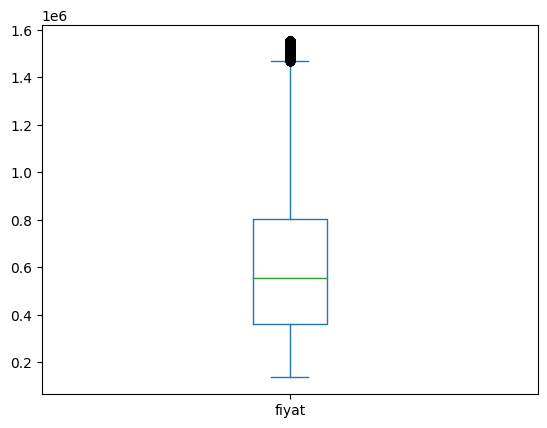

In [48]:
df_araba["fiyat"].plot(kind="box")

In [49]:
Q1=df_araba.fiyat.quantile(0.25)                           #1. çeyreği alıyoruz
Q3=df_araba.fiyat.quantile(0.75)         #3. çeyrek
IQR=Q3-Q1
print("Q1: ", Q1)
print("Q3: ", Q3)
print("IQR: ", IQR)

Q1:  359000.0
Q3:  802500.0
IQR:  443500.0


In [50]:
#  AYKIRI DEĞER HESABI

aykiri=Q3 + 1.5*IQR
print(aykiri)

#1467750.0 bundan büyükler aykırı

1467750.0


In [51]:
#  AYKIRI DEĞER HESABI

aykiri2=Q1 - 1.5*IQR
print(aykiri2)

#-306250.0 - olduğu için bakmaya gerek yok

-306250.0


In [52]:
# Aykırı değerlerin sınırını hesaplama

aykiri_sinir = aykiri
temizlenmis_df = df_araba[df_araba['fiyat'] <= aykiri_sinir]

df_araba = temizlenmis_df.copy()


In [53]:
print(df_araba)

           ilan_id                                       ilan_basligi  \
0       1080850207  DEĞİŞENSİZ YENİ MUAYENELİ RENAULT MEGANE FUL D...   
1       1101850722           KAZA,BOYA,DEĞİŞEN,TRAMER YOK. 80.000 km.   
2       1101855061                 HATASIZ AYARINDA MASRAFSIZ AUDİ A3   
3       1101851921  2020/A3 35 1.5 TFSİ/150 DESIGN+STRONIC PKT-SUN...   
4       1090594643                                         2015 MODEL   
...            ...                                                ...   
556750  1101864569                          RENAULT MEGANE DEĞİŞENSİZ   
556751  1101751328                              Sahibinden Temiz Polo   
556753  1101865698                                         2015 MODEL   
556754  1101865188          *MK AUTO*DAN BOYASIZ EDC JANZUMAN MEGAN 4   
556755  1101864410        OTOMATİK HASAR KAYITSIZ DEĞİŞENSİZ DÜŞÜK KM   

            fiyat fiyat_kuru                 ilan_tarihi  \
0        830000.0         TL  2023-05-26 09:23:29.000000   
1  

<AxesSubplot:>

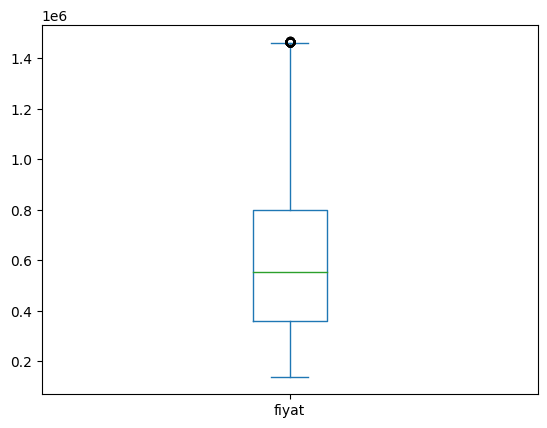

In [54]:
df_araba["fiyat"].plot(kind="box")

In [55]:
print(df_araba.dtypes)

ilan_id               int64
ilan_basligi         object
fiyat               float64
fiyat_kuru           object
ilan_tarihi          object
ilan_kategorisi      object
arac_tagleri         object
ilan_konumu          object
arac_ozellikleri     object
Kilometre            object
motor_gucu           object
Yakit                object
Marka                object
Seri                 object
Model_Yili           object
Sehir                object
tarih                object
ilce                 object
dtype: object


In [56]:
df_araba['Kilometre'] = pd.to_numeric(df_araba['Kilometre'], errors='coerce')
df_araba['Model_Yili'] = pd.to_numeric(df_araba['Model_Yili'], errors='coerce')
df_araba['motor_gucu'] = pd.to_numeric(df_araba['motor_gucu'], errors='coerce')


In [57]:
print(df_araba.dtypes)

ilan_id               int64
ilan_basligi         object
fiyat               float64
fiyat_kuru           object
ilan_tarihi          object
ilan_kategorisi      object
arac_tagleri         object
ilan_konumu          object
arac_ozellikleri     object
Kilometre           float64
motor_gucu          float64
Yakit                object
Marka                object
Seri                 object
Model_Yili          float64
Sehir                object
tarih                object
ilce                 object
dtype: object


<AxesSubplot:>

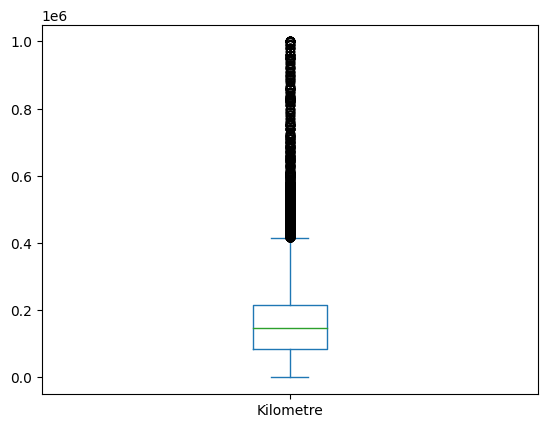

In [58]:
df_araba["Kilometre"].plot(kind="box")

In [59]:
Q1=df_araba.Kilometre.quantile(0.25)  #1. çeyreği alıyoruz
Q3=df_araba.Kilometre.quantile(0.75)  #3. çeyrek
IQR=Q3-Q1
print("Q1: ", Q1)
print("Q3: ", Q3)
print("IQR: ", IQR)

Q1:  84000.0
Q3:  217000.0
IQR:  133000.0


In [60]:
#  AYKIRI DEĞER HESABI

aykiri=Q3 + 1.5*IQR
print(aykiri)
aykiri2=Q1 - 1.5*IQR
print(aykiri2)

#416500.0 bundan büyükler aykırı

416500.0
-115500.0


In [61]:
#  AYKIRI DEĞER HESABI
aykiri2=Q1 - 1.5*IQR
print(aykiri2)
#-115500.0 - olduğu için bakmaya gerek yok

-115500.0


In [62]:
# Aykırı değerlerin sınırını hesaplama

aykiri_sinir = aykiri
temizlenmis_df = df_araba[df_araba['Kilometre'] <= aykiri_sinir]
df_araba = temizlenmis_df.copy()

<AxesSubplot:>

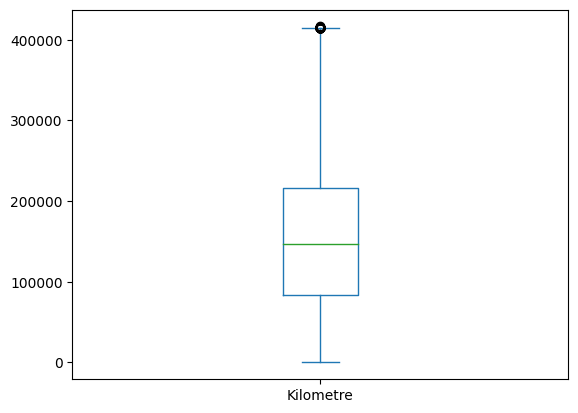

In [63]:
df_araba["Kilometre"].plot(kind="box")

In [64]:
print(df_araba)

           ilan_id                                       ilan_basligi  \
0       1080850207  DEĞİŞENSİZ YENİ MUAYENELİ RENAULT MEGANE FUL D...   
1       1101850722           KAZA,BOYA,DEĞİŞEN,TRAMER YOK. 80.000 km.   
2       1101855061                 HATASIZ AYARINDA MASRAFSIZ AUDİ A3   
3       1101851921  2020/A3 35 1.5 TFSİ/150 DESIGN+STRONIC PKT-SUN...   
4       1090594643                                         2015 MODEL   
...            ...                                                ...   
556750  1101864569                          RENAULT MEGANE DEĞİŞENSİZ   
556751  1101751328                              Sahibinden Temiz Polo   
556753  1101865698                                         2015 MODEL   
556754  1101865188          *MK AUTO*DAN BOYASIZ EDC JANZUMAN MEGAN 4   
556755  1101864410        OTOMATİK HASAR KAYITSIZ DEĞİŞENSİZ DÜŞÜK KM   

            fiyat fiyat_kuru                 ilan_tarihi  \
0        830000.0         TL  2023-05-26 09:23:29.000000   
1  

In [65]:
dusuk_km_indeksler = df_araba[df_araba['Kilometre'] < 500].index

print("500 kilometreden az olan araçların indeksleri:", dusuk_km_indeksler)

500 kilometreden az olan araçların indeksleri: Int64Index([  5788,  14625,  34778,  36957,  43966,  47696,  53368,  69544,
             70992, 131674, 140783, 141677, 173774, 180143, 180151, 180152,
            180246, 180267, 180275, 180353, 180562, 180590, 181551, 181575,
            182273, 182584, 183430, 184223, 185036, 185108, 185329, 185378,
            185749, 185962, 186241, 186286, 186500, 187252, 188748, 189242,
            189972, 192216, 192870, 193405, 195479, 196905, 198766, 199997,
            200479, 200650, 200651, 200960, 201352, 204445, 207596, 208088,
            208122, 208340, 208407, 209368, 209614, 209953, 211609, 212546,
            212683, 212849, 225384, 227038, 241973, 251818, 261480, 264276,
            264323, 271202, 360929, 367055, 370989, 408669, 417931, 435482,
            438827, 451505, 458790, 509508, 521444, 526576, 533210, 555228],
           dtype='int64')


In [66]:
df_araba = df_araba.drop(dusuk_km_indeksler)

In [67]:
print(df_araba)

           ilan_id                                       ilan_basligi  \
0       1080850207  DEĞİŞENSİZ YENİ MUAYENELİ RENAULT MEGANE FUL D...   
1       1101850722           KAZA,BOYA,DEĞİŞEN,TRAMER YOK. 80.000 km.   
2       1101855061                 HATASIZ AYARINDA MASRAFSIZ AUDİ A3   
3       1101851921  2020/A3 35 1.5 TFSİ/150 DESIGN+STRONIC PKT-SUN...   
4       1090594643                                         2015 MODEL   
...            ...                                                ...   
556750  1101864569                          RENAULT MEGANE DEĞİŞENSİZ   
556751  1101751328                              Sahibinden Temiz Polo   
556753  1101865698                                         2015 MODEL   
556754  1101865188          *MK AUTO*DAN BOYASIZ EDC JANZUMAN MEGAN 4   
556755  1101864410        OTOMATİK HASAR KAYITSIZ DEĞİŞENSİZ DÜŞÜK KM   

            fiyat fiyat_kuru                 ilan_tarihi  \
0        830000.0         TL  2023-05-26 09:23:29.000000   
1  

In [68]:
# 'Marka' sütununda 'Bilinmeyen Marka' değerine sahip satırları filtreleyerek yeni bir DataFrame oluşturma

df_araba = df_araba[df_araba['Marka'] != 'Bilinmeyen Marka']


print("Yeni DataFrame satır sayısı:", len(df_araba))

Yeni DataFrame satır sayısı: 541468


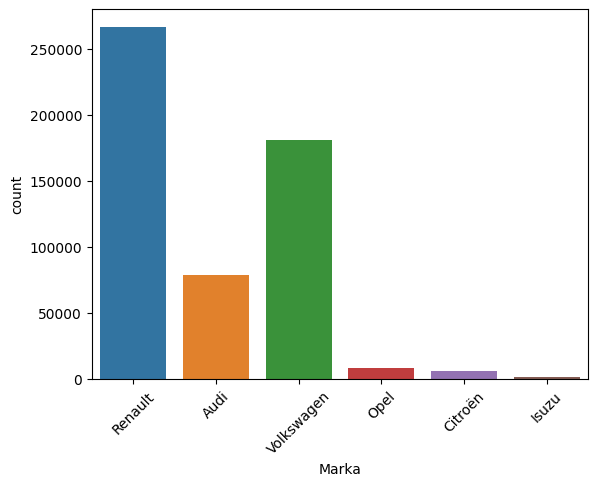

In [69]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.countplot(data=df_araba, x='Marka')
plt.xticks(rotation=45)
plt.show()

In [70]:
print(df_araba["motor_gucu"].head(58))

0     110.0
1     110.0
2     102.0
3     150.0
4      75.0
5     110.0
6       NaN
7     110.0
8     115.0
9     140.0
10     75.0
11    140.0
12    106.0
13    110.0
14    140.0
15     98.0
16    105.0
17    140.0
18      NaN
19     85.0
20    100.0
21    102.0
22    110.0
23    115.0
24     85.0
26    140.0
27     86.0
28     75.0
29     90.0
30    110.0
31     70.0
32     95.0
33    110.0
34    140.0
35    110.0
36    110.0
37     90.0
38    110.0
39    110.0
40    140.0
41     98.0
42    110.0
43     90.0
44    115.0
45     90.0
46     60.0
47     90.0
48    110.0
49    110.0
50     90.0
51     75.0
52    110.0
53    110.0
54      NaN
55    110.0
56      NaN
57     75.0
58    110.0
Name: motor_gucu, dtype: float64


In [71]:
# 'fiyat' sütunundaki eksik değerlerin indekslerini bulma


eksik_deger_indeksleri = df_araba[df_araba['motor_gucu'].isnull()].index

print("Eksik değerlerin indeksleri:", eksik_deger_indeksleri)
print("Toplam eksik değer sayısı:", len(eksik_deger_indeksleri))


Eksik değerlerin indeksleri: Int64Index([     6,     18,     54,     56,     72,     97,    111,    139,
               225,    268,
            ...
            556261, 556262, 556268, 556350, 556443, 556506, 556520, 556523,
            556530, 556632],
           dtype='int64', length=23610)
Toplam eksik değer sayısı: 23610


In [72]:
# Eksik değerlere sahip olan belirli indekslerdeki satırları silme

df_araba.drop(index=eksik_deger_indeksleri, inplace=True)


In [73]:
# Değişiklikleri kontrol etmek için ilk birkaç satırı gösterelim
print(df_araba)


           ilan_id                                       ilan_basligi  \
0       1080850207  DEĞİŞENSİZ YENİ MUAYENELİ RENAULT MEGANE FUL D...   
1       1101850722           KAZA,BOYA,DEĞİŞEN,TRAMER YOK. 80.000 km.   
2       1101855061                 HATASIZ AYARINDA MASRAFSIZ AUDİ A3   
3       1101851921  2020/A3 35 1.5 TFSİ/150 DESIGN+STRONIC PKT-SUN...   
4       1090594643                                         2015 MODEL   
...            ...                                                ...   
556750  1101864569                          RENAULT MEGANE DEĞİŞENSİZ   
556751  1101751328                              Sahibinden Temiz Polo   
556753  1101865698                                         2015 MODEL   
556754  1101865188          *MK AUTO*DAN BOYASIZ EDC JANZUMAN MEGAN 4   
556755  1101864410        OTOMATİK HASAR KAYITSIZ DEĞİŞENSİZ DÜŞÜK KM   

            fiyat fiyat_kuru                 ilan_tarihi  \
0        830000.0         TL  2023-05-26 09:23:29.000000   
1  

In [74]:
df_araba['motor_gucu'] = df_araba['motor_gucu'].astype(int)

In [75]:
print(df_araba.dtypes)

ilan_id               int64
ilan_basligi         object
fiyat               float64
fiyat_kuru           object
ilan_tarihi          object
ilan_kategorisi      object
arac_tagleri         object
ilan_konumu          object
arac_ozellikleri     object
Kilometre           float64
motor_gucu            int32
Yakit                object
Marka                object
Seri                 object
Model_Yili          float64
Sehir                object
tarih                object
ilce                 object
dtype: object


In [76]:
df_araba['Model_Yili'] = df_araba['Model_Yili'].astype(int)

In [77]:
print(df_araba.dtypes)

ilan_id               int64
ilan_basligi         object
fiyat               float64
fiyat_kuru           object
ilan_tarihi          object
ilan_kategorisi      object
arac_tagleri         object
ilan_konumu          object
arac_ozellikleri     object
Kilometre           float64
motor_gucu            int32
Yakit                object
Marka                object
Seri                 object
Model_Yili            int32
Sehir                object
tarih                object
ilce                 object
dtype: object


In [78]:
print(df_araba["motor_gucu"])

0         110
1         110
2         102
3         150
4          75
         ... 
556750     98
556751     90
556753     75
556754    115
556755    102
Name: motor_gucu, Length: 517858, dtype: int32


In [79]:
# Sayısal olmayan veya 0 değerlerini içeren satırları bulma
filtre = ~df_araba['motor_gucu'].apply(lambda x: str(x).isdigit()) | (df_araba['motor_gucu'] == 0)
problematic_rows = df_araba[filtre]

print(problematic_rows)


Empty DataFrame
Columns: [ilan_id, ilan_basligi, fiyat, fiyat_kuru, ilan_tarihi, ilan_kategorisi, arac_tagleri, ilan_konumu, arac_ozellikleri, Kilometre, motor_gucu, Yakit, Marka, Seri, Model_Yili, Sehir, tarih, ilce]
Index: []


<AxesSubplot:>

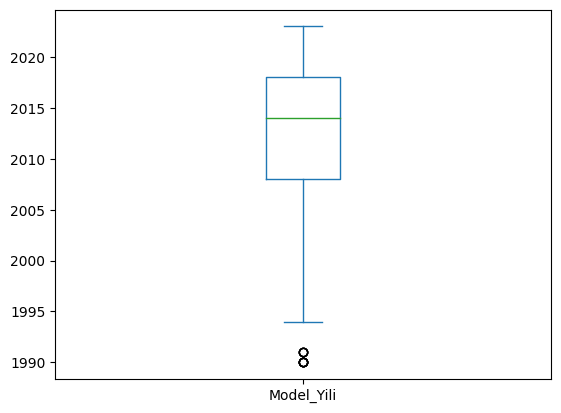

In [80]:
#model yılı aykırı değer hesabı
df_araba["Model_Yili"].plot(kind="box")

In [81]:
Q1=df_araba["Model_Yili"].quantile(0.25)  #1. çeyreği alıyoruz
Q3=df_araba["Model_Yili"].quantile(0.75)  #3. çeyrek
IQR=Q3-Q1
print("Q1: ", Q1)
print("Q3: ", Q3)
print("IQR: ", IQR)

Q1:  2008.0
Q3:  2018.0
IQR:  10.0


In [82]:
aykiri=Q3 + 1.5*IQR
print(aykiri)
aykiri2=Q1 - 1.5*IQR
print(aykiri2)

2033.0
1993.0


In [83]:
temiz_veri = df_araba[df_araba["Model_Yili"] >= aykiri2] 
df_araba=temiz_veri.copy()

<AxesSubplot:>

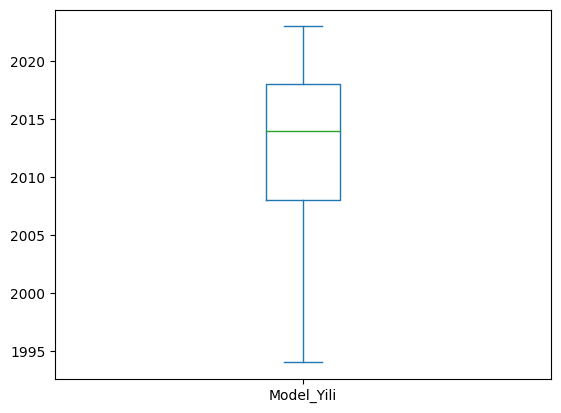

In [84]:
df_araba["Model_Yili"].plot(kind="box")

In [85]:
print(df_araba.shape)

(517848, 18)


In [86]:
print(df_araba["Model_Yili"])

0         2016
1         2017
2         2011
3         2020
4         2015
          ... 
556750    2007
556751    2016
556753    2015
556754    2020
556755    2007
Name: Model_Yili, Length: 517848, dtype: int32


<AxesSubplot:>

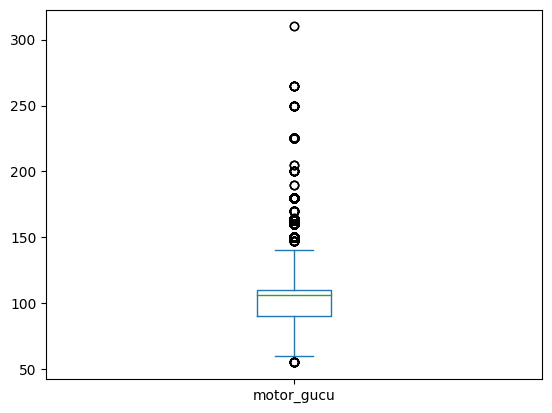

In [87]:
#motor gücü aykırı değer hesabı
df_araba["motor_gucu"].plot(kind="box")

In [88]:
Q1=df_araba["motor_gucu"].quantile(0.25)  #1. çeyreği alıyoruz
Q3=df_araba["motor_gucu"].quantile(0.75)  #3. çeyrek
IQR=Q3-Q1
print("Q1: ", Q1)
print("Q3: ", Q3)
print("IQR: ", IQR)

Q1:  90.0
Q3:  110.0
IQR:  20.0


In [89]:
aykiri=Q3 + 1.5*IQR
print(aykiri)
aykiri2=Q1 - 1.5*IQR
print(aykiri2)

140.0
60.0


In [90]:
temiz_veri = df_araba[(df_araba["motor_gucu"] >= aykiri2) & (df_araba["motor_gucu"] <= aykiri)]
df_araba=temiz_veri.copy()

In [91]:
print(df_araba.shape)

(508174, 18)


<AxesSubplot:>

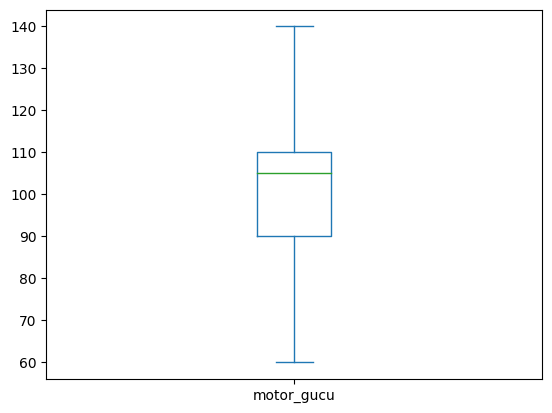

In [92]:
df_araba["motor_gucu"].plot(kind="box")

In [93]:
print(df_araba.dtypes)

ilan_id               int64
ilan_basligi         object
fiyat               float64
fiyat_kuru           object
ilan_tarihi          object
ilan_kategorisi      object
arac_tagleri         object
ilan_konumu          object
arac_ozellikleri     object
Kilometre           float64
motor_gucu            int32
Yakit                object
Marka                object
Seri                 object
Model_Yili            int32
Sehir                object
tarih                object
ilce                 object
dtype: object


In [94]:
#ARAÇ YAŞI HESAPLAMA
# Mevcut yıl

yil = 2023
arac_model = df_araba['Model_Yili']                      # 'Model_Yili' sütununu guncel_df'den çekme
arac_yaslari = []
for model_yili in arac_model:
    yas = yil - model_yili
    arac_yaslari.append(yas)                              # Yeni 'arac_yasi' sütununu DataFrame'e ekleme
df_araba['arac_yasi'] = arac_yaslari

print(df_araba['arac_yasi'])


0          7
1          6
2         12
4          8
5         10
          ..
556750    16
556751     7
556753     8
556754     3
556755    16
Name: arac_yasi, Length: 508174, dtype: int64


In [95]:
print(df_araba.dtypes)

ilan_id               int64
ilan_basligi         object
fiyat               float64
fiyat_kuru           object
ilan_tarihi          object
ilan_kategorisi      object
arac_tagleri         object
ilan_konumu          object
arac_ozellikleri     object
Kilometre           float64
motor_gucu            int32
Yakit                object
Marka                object
Seri                 object
Model_Yili            int32
Sehir                object
tarih                object
ilce                 object
arac_yasi             int64
dtype: object


In [96]:
#ARAÇ YIPRANMA YÜZDELERİ

def yipranma_yuzdesi_hesapla(model_yili, km):
    arac_yasi = yil - model_yili
    if arac_yasi != 0:
        yipranma_yuzdesi = (km / (arac_yasi * 20000)) * 100  
    else:
        yipranma_yuzdesi = 0
    return yipranma_yuzdesi
yil = 2023
df_araba['yipranma_yuzdesi'] = df_araba.apply(lambda row: yipranma_yuzdesi_hesapla(row['Model_Yili'], row['Kilometre']), axis=1)
print(df_araba['yipranma_yuzdesi'])

0         102.142857
1          66.666667
2          73.750000
4          78.125000
5          45.250000
             ...    
556750     73.437500
556751     40.714286
556753    128.125000
556754     36.666667
556755     56.562500
Name: yipranma_yuzdesi, Length: 508174, dtype: float64


In [97]:
#YIPRANMADAKİ BOŞ DEĞERLER
nan_degerler = df_araba[df_araba['yipranma_yuzdesi'].isnull()]
print(nan_degerler)

Empty DataFrame
Columns: [ilan_id, ilan_basligi, fiyat, fiyat_kuru, ilan_tarihi, ilan_kategorisi, arac_tagleri, ilan_konumu, arac_ozellikleri, Kilometre, motor_gucu, Yakit, Marka, Seri, Model_Yili, Sehir, tarih, ilce, arac_yasi, yipranma_yuzdesi]
Index: []


In [98]:
#ARAÇ YAŞINDAKİ EKSİKLER
# Tam sayı olmayan veya karakter içeren değerleri kontrol etme
filtre = ~df_araba['arac_yasi'].apply(lambda x: str(x).isdigit())
problematic_rows = df_araba[filtre]

print(problematic_rows['arac_yasi'])


Series([], Name: arac_yasi, dtype: int64)


In [99]:
print(df_araba.shape)

(508174, 20)


In [100]:
print(df_araba.columns)

Index(['ilan_id', 'ilan_basligi', 'fiyat', 'fiyat_kuru', 'ilan_tarihi',
       'ilan_kategorisi', 'arac_tagleri', 'ilan_konumu', 'arac_ozellikleri',
       'Kilometre', 'motor_gucu', 'Yakit', 'Marka', 'Seri', 'Model_Yili',
       'Sehir', 'tarih', 'ilce', 'arac_yasi', 'yipranma_yuzdesi'],
      dtype='object')


In [101]:
print(df_araba["tarih"])

0         2023-05-26
1         2023-05-26
2         2023-05-26
4         2023-05-26
5         2023-05-26
             ...    
556750    2023-05-26
556751    2023-05-26
556753    2023-05-26
556754    2023-05-26
556755    2023-05-26
Name: tarih, Length: 508174, dtype: object


In [102]:
#İLANDA KALMA SÜRELERİ

import pandas as pd

from datetime import datetime
bugunun_tarihi = datetime.now().date()
df_araba['tarih-fark'] = bugunun_tarihi - df_araba['tarih']


print(df_araba['tarih-fark'])

0        459 days
1        459 days
2        459 days
4        459 days
5        459 days
           ...   
556750   459 days
556751   459 days
556753   459 days
556754   459 days
556755   459 days
Name: tarih-fark, Length: 508174, dtype: timedelta64[ns]


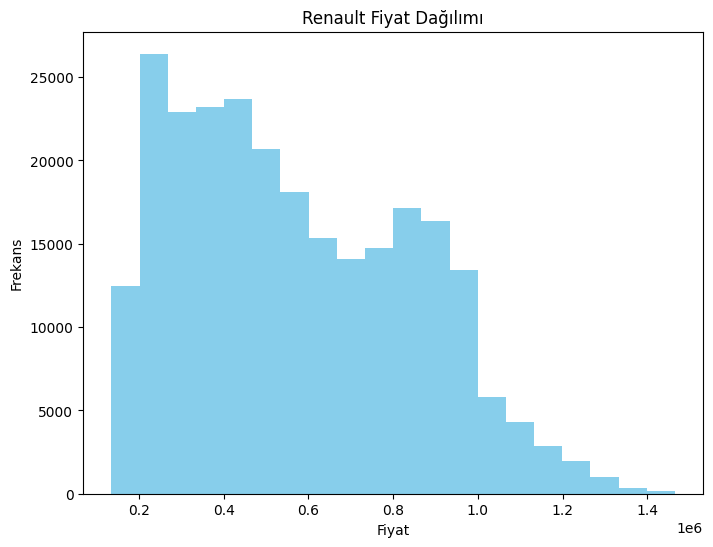

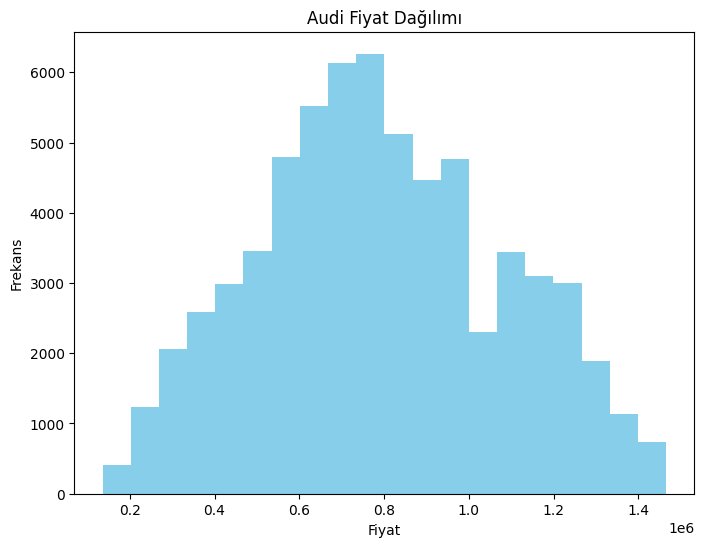

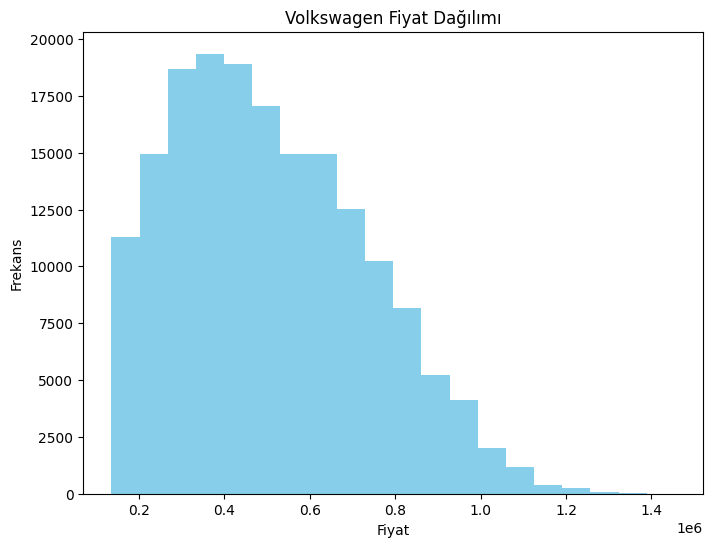

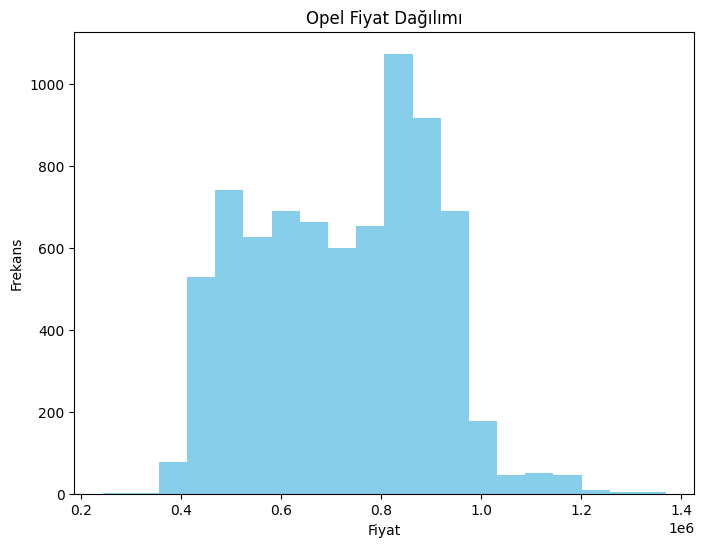

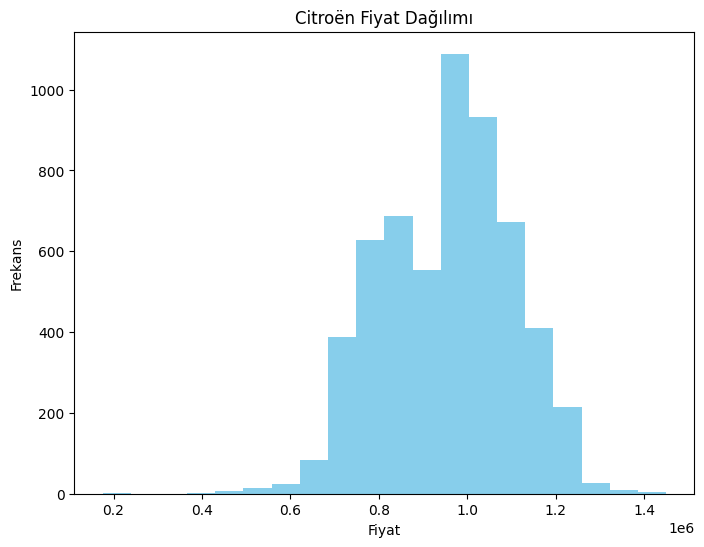

In [103]:
import matplotlib.pyplot as plt

markalar = df_araba['Marka'].unique()

for marka in markalar:
    marka_df = df_araba[df_araba['Marka'] == marka]
    plt.figure(figsize=(8, 6))
    plt.hist(marka_df['fiyat'], bins=20, color='skyblue')  # Histogram
    plt.title(f'{marka} Fiyat Dağılımı')
    plt.xlabel('Fiyat')
    plt.ylabel('Frekans')
    plt.show()


In [104]:
print(df_araba.columns)

Index(['ilan_id', 'ilan_basligi', 'fiyat', 'fiyat_kuru', 'ilan_tarihi',
       'ilan_kategorisi', 'arac_tagleri', 'ilan_konumu', 'arac_ozellikleri',
       'Kilometre', 'motor_gucu', 'Yakit', 'Marka', 'Seri', 'Model_Yili',
       'Sehir', 'tarih', 'ilce', 'arac_yasi', 'yipranma_yuzdesi',
       'tarih-fark'],
      dtype='object')


In [105]:
print(df_araba["tarih-fark"])

0        459 days
1        459 days
2        459 days
4        459 days
5        459 days
           ...   
556750   459 days
556751   459 days
556753   459 days
556754   459 days
556755   459 days
Name: tarih-fark, Length: 508174, dtype: timedelta64[ns]


In [106]:
print(df_araba.corr())

                   ilan_id     fiyat  Kilometre  motor_gucu  Model_Yili  \
ilan_id           1.000000  0.339121   0.036659    0.003344   -0.018128   
fiyat             0.339121  1.000000  -0.620682    0.456873    0.751518   
Kilometre         0.036659 -0.620682   1.000000   -0.358090   -0.736159   
motor_gucu        0.003344  0.456873  -0.358090    1.000000    0.432240   
Model_Yili       -0.018128  0.751518  -0.736159    0.432240    1.000000   
arac_yasi         0.018128 -0.751518   0.736159   -0.432240   -1.000000   
yipranma_yuzdesi  0.061517  0.176874   0.282158    0.111261    0.292967   

                  arac_yasi  yipranma_yuzdesi  
ilan_id            0.018128          0.061517  
fiyat             -0.751518          0.176874  
Kilometre          0.736159          0.282158  
motor_gucu        -0.432240          0.111261  
Model_Yili        -1.000000          0.292967  
arac_yasi          1.000000         -0.292967  
yipranma_yuzdesi  -0.292967          1.000000  


In [107]:
kor=df_araba.corr()

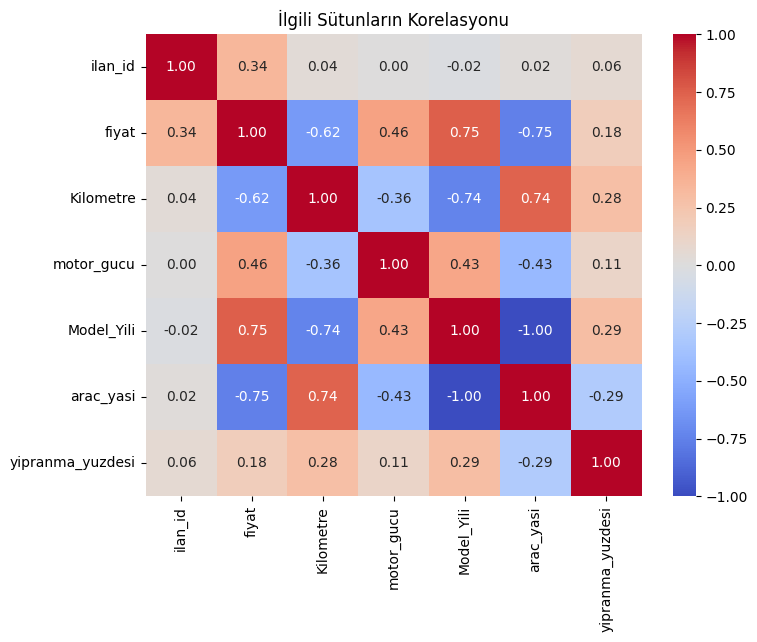

In [108]:
plt.figure(figsize=(8, 6))
sns.heatmap(kor, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('İlgili Sütunların Korelasyonu')
plt.show()

In [109]:
# Fiyat-model yılı-kilometre sütunları seçerek korelasyonu hesaplama

korelasyon_katsayisi = df_araba[['fiyat', 'Model_Yili', 'Kilometre']].corr(method='pearson')
print(korelasyon_katsayisi)

               fiyat  Model_Yili  Kilometre
fiyat       1.000000    0.751518  -0.620682
Model_Yili  0.751518    1.000000  -0.736159
Kilometre  -0.620682   -0.736159   1.000000


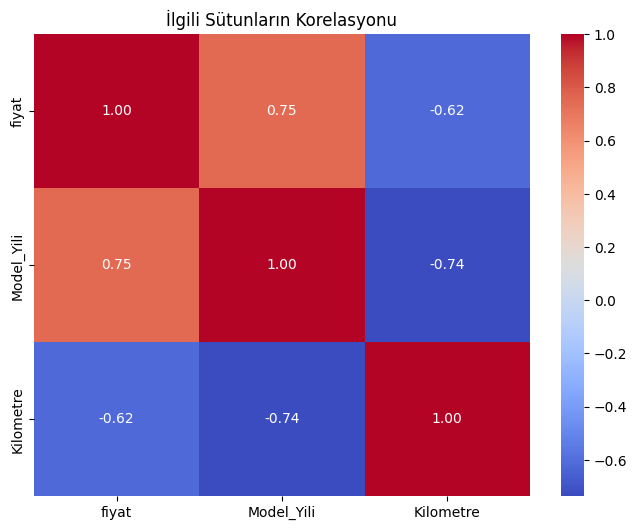

In [110]:
plt.figure(figsize=(8, 6))
sns.heatmap(korelasyon_katsayisi, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('İlgili Sütunların Korelasyonu')
plt.show()

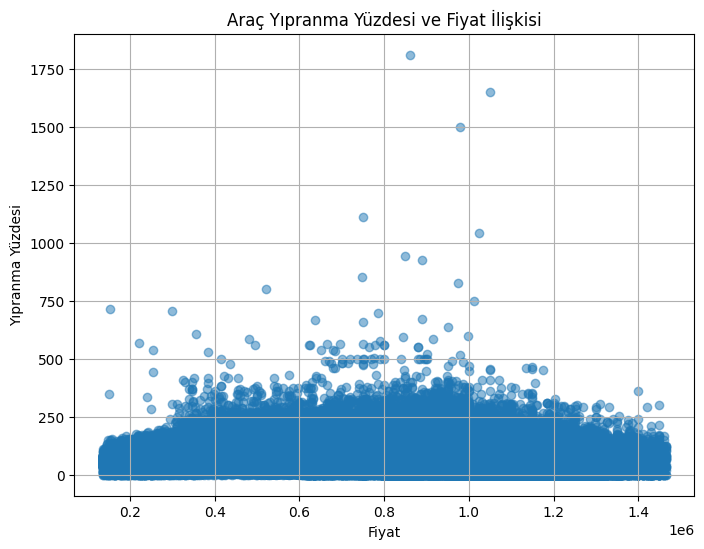

In [111]:
#YIPRANMA FİYAT GRAFİĞİ

yipranma_yuzdesi = df_araba["yipranma_yuzdesi"]
fiyat = df_araba['fiyat']
plt.figure(figsize=(8, 6))
plt.scatter(fiyat, yipranma_yuzdesi, alpha=0.5)
plt.xlabel('Fiyat')
plt.ylabel('Yıpranma Yüzdesi')
plt.title('Araç Yıpranma Yüzdesi ve Fiyat İlişkisi')
plt.grid(True)
plt.show()

C:\Users\ayseg\AppData\Roaming\Python\Python310\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


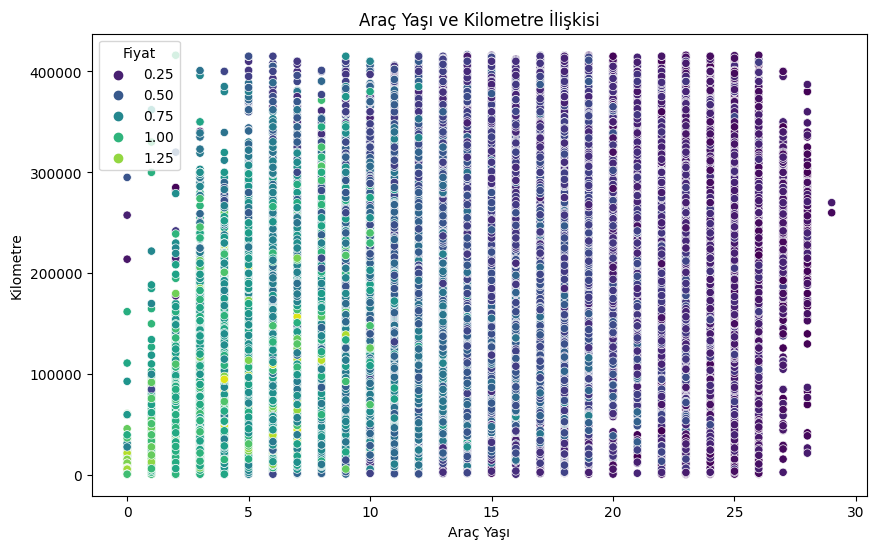

In [112]:
#YAŞ KM

plt.figure(figsize=(10, 6))
sns.scatterplot(x=df_araba["arac_yasi"], y=df_araba["Kilometre"], hue='fiyat', palette='viridis', data=df_araba)
plt.xlabel('Araç Yaşı')
plt.ylabel('Kilometre')
plt.title('Araç Yaşı ve Kilometre İlişkisi')
plt.legend(title='Fiyat')
plt.show()

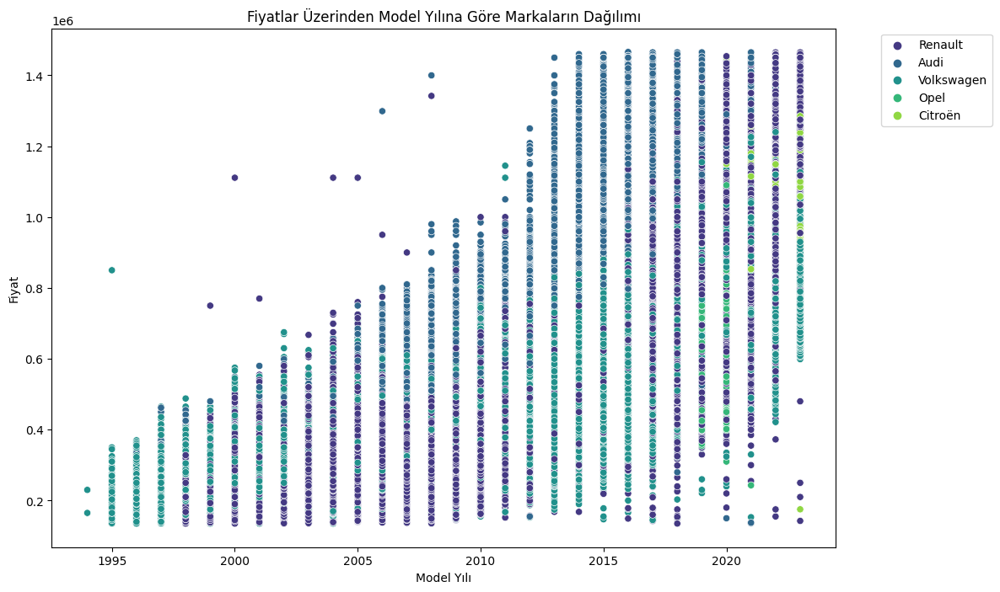

In [113]:
plt.figure(figsize=(12, 8))
sns.scatterplot(data=df_araba, x='Model_Yili', y='fiyat', hue='Marka', palette='viridis', legend='full')
plt.xlabel('Model Yılı')
plt.ylabel('Fiyat')
plt.title('Fiyatlar Üzerinden Model Yılına Göre Markaların Dağılımı')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

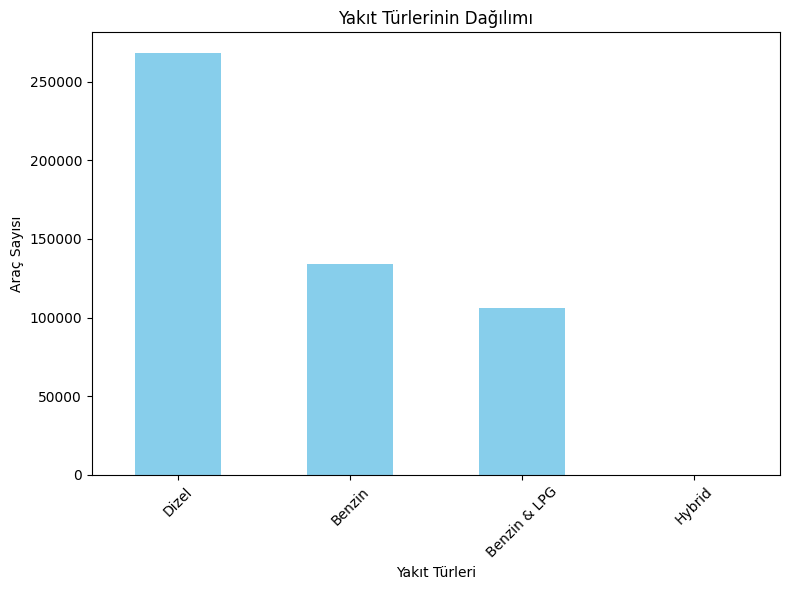

In [114]:
# 1. Yakıt Türlerinin Dağılımı (Bar Grafiği)
plt.figure(figsize=(8, 6))
df_araba['Yakit'].value_counts().plot(kind='bar', color='skyblue')
plt.title('Yakıt Türlerinin Dağılımı')
plt.xlabel('Yakıt Türleri')
plt.ylabel('Araç Sayısı')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

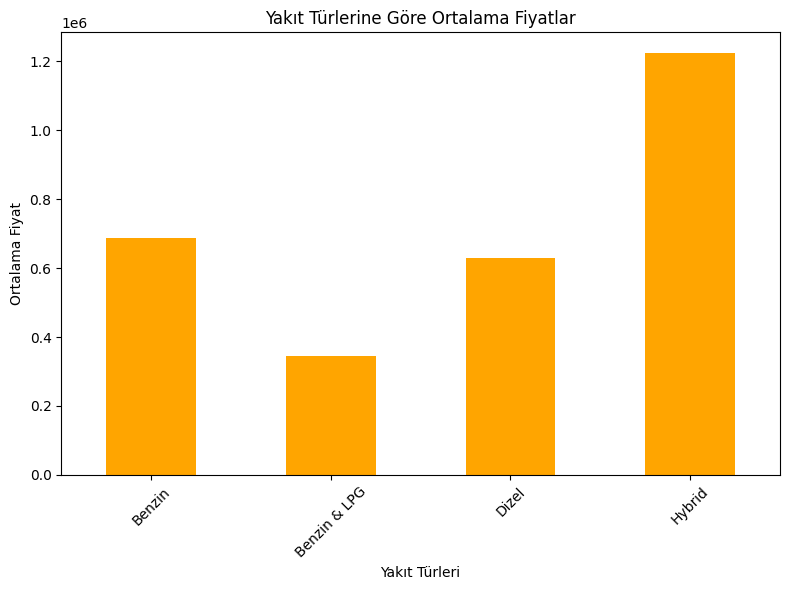

In [115]:
# Yakıt Türlerine Göre Ortalama Fiyatlar (Çubuk Grafiği)

plt.figure(figsize=(8, 6))
df_araba.groupby('Yakit')['fiyat'].mean().plot(kind='bar', color='orange')
plt.title('Yakıt Türlerine Göre Ortalama Fiyatlar')
plt.xlabel('Yakıt Türleri')
plt.ylabel('Ortalama Fiyat')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [116]:
print(df_araba.columns)

Index(['ilan_id', 'ilan_basligi', 'fiyat', 'fiyat_kuru', 'ilan_tarihi',
       'ilan_kategorisi', 'arac_tagleri', 'ilan_konumu', 'arac_ozellikleri',
       'Kilometre', 'motor_gucu', 'Yakit', 'Marka', 'Seri', 'Model_Yili',
       'Sehir', 'tarih', 'ilce', 'arac_yasi', 'yipranma_yuzdesi',
       'tarih-fark'],
      dtype='object')


In [117]:
print(df_araba["tarih-fark"].head(1200))

0      459 days
1      459 days
2      459 days
4      459 days
5      459 days
         ...   
1281   368 days
1282   368 days
1283   368 days
1284   368 days
1286   368 days
Name: tarih-fark, Length: 1200, dtype: timedelta64[ns]


In [118]:
print(df_araba.dtypes)

ilan_id                       int64
ilan_basligi                 object
fiyat                       float64
fiyat_kuru                   object
ilan_tarihi                  object
ilan_kategorisi              object
arac_tagleri                 object
ilan_konumu                  object
arac_ozellikleri             object
Kilometre                   float64
motor_gucu                    int32
Yakit                        object
Marka                        object
Seri                         object
Model_Yili                    int32
Sehir                        object
tarih                        object
ilce                         object
arac_yasi                     int64
yipranma_yuzdesi            float64
tarih-fark          timedelta64[ns]
dtype: object


In [119]:
print(df_araba["tarih-fark"])

0        459 days
1        459 days
2        459 days
4        459 days
5        459 days
           ...   
556750   459 days
556751   459 days
556753   459 days
556754   459 days
556755   459 days
Name: tarih-fark, Length: 508174, dtype: timedelta64[ns]


In [120]:
df_araba['tarih-fark-gün'] = df_araba['tarih-fark'].dt.days

In [121]:
print(df_araba['tarih-fark-gün'])

0         459
1         459
2         459
4         459
5         459
         ... 
556750    459
556751    459
556753    459
556754    459
556755    459
Name: tarih-fark-gün, Length: 508174, dtype: int64


In [122]:
print(df_araba.dtypes)

ilan_id                       int64
ilan_basligi                 object
fiyat                       float64
fiyat_kuru                   object
ilan_tarihi                  object
ilan_kategorisi              object
arac_tagleri                 object
ilan_konumu                  object
arac_ozellikleri             object
Kilometre                   float64
motor_gucu                    int32
Yakit                        object
Marka                        object
Seri                         object
Model_Yili                    int32
Sehir                        object
tarih                        object
ilce                         object
arac_yasi                     int64
yipranma_yuzdesi            float64
tarih-fark          timedelta64[ns]
tarih-fark-gün                int64
dtype: object


In [123]:
# timedelta64[ns] tipindeki sütunu int tipine dönüştürme
df_araba['tarih-fark'] = df_araba['tarih-fark'].dt.days.astype(int)

In [124]:
print(df_araba.dtypes)

ilan_id               int64
ilan_basligi         object
fiyat               float64
fiyat_kuru           object
ilan_tarihi          object
ilan_kategorisi      object
arac_tagleri         object
ilan_konumu          object
arac_ozellikleri     object
Kilometre           float64
motor_gucu            int32
Yakit                object
Marka                object
Seri                 object
Model_Yili            int32
Sehir                object
tarih                object
ilce                 object
arac_yasi             int64
yipranma_yuzdesi    float64
tarih-fark            int32
tarih-fark-gün        int64
dtype: object


In [125]:
print(df_araba["tarih-fark-gün"].unique())

[ 459  369  368  458  457  367  456  455  366  454  484  464  453  452
  365  451  448  364  450  449  363  447  362  446  361  445  444  360
  443  359  442  358  441  357  440  356  439  355  438  354  390  437
  436  353  435  352  434  351  433  350  432  431  349  430  348  429
  428  427  426  425  424  423  422  421  420  331  332  330  329  328
  327  326  325  324  323  322  321  320  319  318  317  316  315  345
  314  313  343  312  311  310  694  575  493  347  693  574  573  419
  478  472  465  596  692  771  631  549  486  594  498  629  572  628
  595  470  627  571  754  691  570  468  640  759  508  511  742  461
  569  756  476  690  705  663  481  568  475  677  624  689  346  597
  567  469  418  566  639  688  617  565  417  576  564  687  616  563
  416  344  686  562  561  415  614  560  685  613  638  559  612  414
  684  342  558  591  557  589  611  683  413  556  341  609  610  555
  682  717  412  720  697  718  662  715  492  714  716  713  709  710
  676 

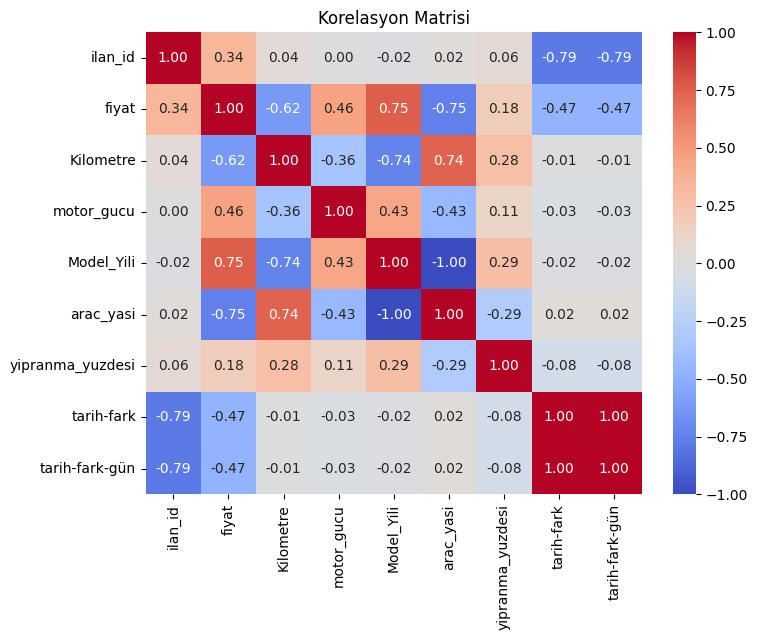

In [126]:
korr=df_araba.corr()
plt.figure(figsize=(8, 6))
sns.heatmap(korr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Korelasyon Matrisi')
plt.show()

In [127]:
print(df_araba["arac_yasi"])

0          7
1          6
2         12
4          8
5         10
          ..
556750    16
556751     7
556753     8
556754     3
556755    16
Name: arac_yasi, Length: 508174, dtype: int64


In [128]:
print(df_araba.shape)

(508174, 22)


In [129]:
benzersiz_yakit_sayisi = df_araba["Yakit"].value_counts().reset_index()
benzersiz_yakit_sayisi.columns = ['Yakit', 'Adet']

print(tabulate(benzersiz_yakit_sayisi, headers='keys', tablefmt='pretty'))


+---+--------------+--------+
|   |    Yakit     |  Adet  |
+---+--------------+--------+
| 0 |    Dizel     | 267991 |
| 1 |    Benzin    | 134182 |
| 2 | Benzin & LPG | 105900 |
| 3 |    Hybrid    |  101   |
+---+--------------+--------+


In [130]:
print(df_araba.info)

<bound method DataFrame.info of            ilan_id                                       ilan_basligi  \
0       1080850207  DEĞİŞENSİZ YENİ MUAYENELİ RENAULT MEGANE FUL D...   
1       1101850722           KAZA,BOYA,DEĞİŞEN,TRAMER YOK. 80.000 km.   
2       1101855061                 HATASIZ AYARINDA MASRAFSIZ AUDİ A3   
4       1090594643                                         2015 MODEL   
5       1101862946  MEGANE 3 ICON OTOMATİK 90.000KM HATASIZ BOYASI...   
...            ...                                                ...   
556750  1101864569                          RENAULT MEGANE DEĞİŞENSİZ   
556751  1101751328                              Sahibinden Temiz Polo   
556753  1101865698                                         2015 MODEL   
556754  1101865188          *MK AUTO*DAN BOYASIZ EDC JANZUMAN MEGAN 4   
556755  1101864410        OTOMATİK HASAR KAYITSIZ DEĞİŞENSİZ DÜŞÜK KM   

           fiyat fiyat_kuru                 ilan_tarihi  \
0       830000.0         TL  202

In [131]:
############################ MAKİNE ÖĞRENİMİ
print(df_araba.columns)

Index(['ilan_id', 'ilan_basligi', 'fiyat', 'fiyat_kuru', 'ilan_tarihi',
       'ilan_kategorisi', 'arac_tagleri', 'ilan_konumu', 'arac_ozellikleri',
       'Kilometre', 'motor_gucu', 'Yakit', 'Marka', 'Seri', 'Model_Yili',
       'Sehir', 'tarih', 'ilce', 'arac_yasi', 'yipranma_yuzdesi', 'tarih-fark',
       'tarih-fark-gün'],
      dtype='object')


In [132]:
guncel_df_encoded = pd.get_dummies(df_araba, columns=['Marka'])

In [133]:
guncel_df_encoded.columns

Index(['ilan_id', 'ilan_basligi', 'fiyat', 'fiyat_kuru', 'ilan_tarihi',
       'ilan_kategorisi', 'arac_tagleri', 'ilan_konumu', 'arac_ozellikleri',
       'Kilometre', 'motor_gucu', 'Yakit', 'Seri', 'Model_Yili', 'Sehir',
       'tarih', 'ilce', 'arac_yasi', 'yipranma_yuzdesi', 'tarih-fark',
       'tarih-fark-gün', 'Marka_Audi', 'Marka_Citroën', 'Marka_Opel',
       'Marka_Renault', 'Marka_Volkswagen'],
      dtype='object')

In [134]:
print(guncel_df_encoded.dtypes)

ilan_id               int64
ilan_basligi         object
fiyat               float64
fiyat_kuru           object
ilan_tarihi          object
ilan_kategorisi      object
arac_tagleri         object
ilan_konumu          object
arac_ozellikleri     object
Kilometre           float64
motor_gucu            int32
Yakit                object
Seri                 object
Model_Yili            int32
Sehir                object
tarih                object
ilce                 object
arac_yasi             int64
yipranma_yuzdesi    float64
tarih-fark            int32
tarih-fark-gün        int64
Marka_Audi            uint8
Marka_Citroën         uint8
Marka_Opel            uint8
Marka_Renault         uint8
Marka_Volkswagen      uint8
dtype: object


In [135]:
#yapay sinir ağı

In [136]:
#YAPAY SİNİR AĞLARI

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.model_selection import train_test_split

X = guncel_df_encoded.drop(['ilan_id', 'ilan_basligi', 'fiyat', 'fiyat_kuru', 'ilan_tarihi',
       'ilan_kategorisi', 'arac_tagleri', 'ilan_konumu', 'arac_ozellikleri','Yakit', 'Sehir', 'tarih',
       'ilce', 'yipranma_yuzdesi', 'tarih-fark', 'Seri'], axis=1)
y = guncel_df_encoded['fiyat']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = Sequential()
model.add(Dense(64, activation='relu', input_shape=(X_train.shape[1],)))  
model.add(Dense(128, activation='relu'))                     
model.add(Dense(64, activation='relu'))  
model.add(Dense(1)) 
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mean_absolute_error'])

model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))

y_pred = model.predict(X_test)

evaluation = model.evaluate(X_test, y_test)
print("Loss:", evaluation[0])
print("Mean Absolute Error:", evaluation[1])

Epoch 1/100


C:\Users\ayseg\AppData\Roaming\Python\Python310\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


12705/12705 ━━━━━━━━━━━━━━━━━━━━ 12s 882us/step - loss: 61169262592.0000 - mean_absolute_error: 176297.6250 - val_loss: 15876059136.0000 - val_mean_absolute_error: 91233.7266
Epoch 2/100
12705/12705 ━━━━━━━━━━━━━━━━━━━━ 11s 839us/step - loss: 15987569664.0000 - mean_absolute_error: 93320.4297 - val_loss: 10941423616.0000 - val_mean_absolute_error: 75291.4922
Epoch 3/100
12705/12705 ━━━━━━━━━━━━━━━━━━━━ 11s 851us/step - loss: 12028928000.0000 - mean_absolute_error: 80095.8594 - val_loss: 9647887360.0000 - val_mean_absolute_error: 72917.1406
Epoch 4/100
12705/12705 ━━━━━━━━━━━━━━━━━━━━ 11s 867us/step - loss: 10574915584.0000 - mean_absolute_error: 75221.8672 - val_loss: 7958547968.0000 - val_mean_absolute_error: 63777.6758
Epoch 5/100
12705/12705 ━━━━━━━━━━━━━━━━━━━━ 11s 880us/step - loss: 9389900800.0000 - mean_absolute_error: 71294.9766 - val_loss: 7058310656.0000 - val_mean_absolute_error: 59987.9258
Epoch 6/100
12705/12705 ━━━━━━━━━━━━━━━━━━━━ 11s 877us/step - loss: 8555226112.0000 -

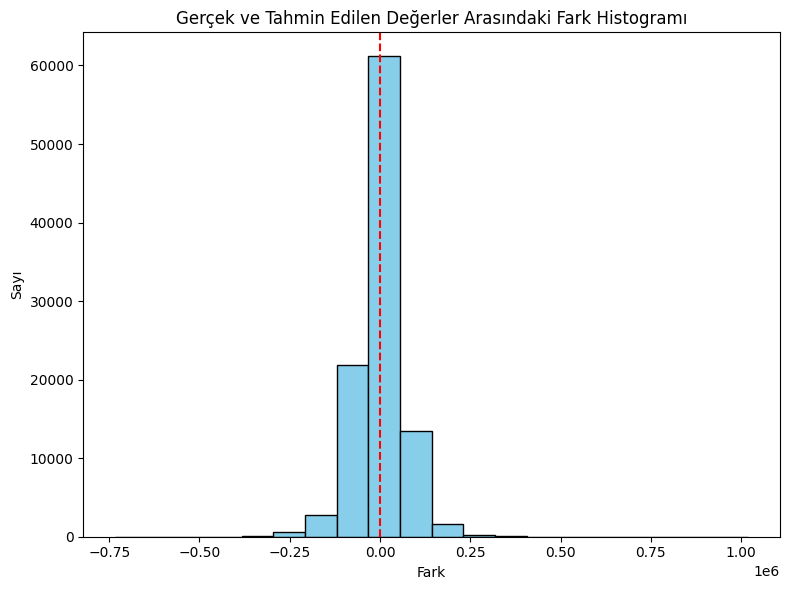

In [137]:
pred_df = pd.DataFrame({'Tahmin Edilen': y_pred.flatten(), 'Gerçek Değerler': y_test.values})

# Histogramı oluşturun
plt.figure(figsize=(8, 6))
plt.hist(pred_df['Tahmin Edilen'] - pred_df['Gerçek Değerler'], bins=20, color='skyblue', edgecolor='black')
plt.axvline(x=0, color='red', linestyle='--')  
plt.title('Gerçek ve Tahmin Edilen Değerler Arasındaki Fark Histogramı')
plt.xlabel('Fark')
plt.ylabel('Sayı')
plt.tight_layout()
plt.show()

In [138]:
from sklearn.metrics import mean_squared_error,r2_score
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error (MSE):", mse)
r2_square = r2_score(y_test,y_pred)
print(f"R-squared: {r2_square}")

Mean Squared Error (MSE): 4085805050.4858255
R-squared: 0.9460164340891875


In [139]:
import pandas as pd
import numpy as np

results = pd.DataFrame({'Gerçek Değerler': y_test, 'Tahmin Edilen': y_pred.flatten()})

print(results.sample(50)) 

        Gerçek Değerler  Tahmin Edilen
214804         320000.0   4.719068e+05
371800         225000.0   2.207886e+05
310223         238000.0   2.450564e+05
273577         375000.0   3.388481e+05
308495         950000.0   1.017976e+06
517595         530000.0   4.696208e+05
464268         775000.0   6.496737e+05
30068          675900.0   7.306934e+05
431172         725000.0   7.096684e+05
108443         400000.0   4.098397e+05
9582           850000.0   8.001344e+05
345098         270000.0   3.048292e+05
472495        1033000.0   1.072721e+06
213369        1100000.0   1.079672e+06
424113         290000.0   2.633647e+05
532973         729000.0   8.723949e+05
356062         810000.0   6.680395e+05
482010         535000.0   4.687878e+05
147356         335000.0   3.026416e+05
94502          799000.0   8.900303e+05
527627         780000.0   6.198806e+05
438579         849000.0   9.533591e+05
136864         187500.0   2.299672e+05
174521         778000.0   9.529744e+05
390012         768000.0  

In [140]:
#GERÇEK FİYAT-TAHMİN EDİLEN FİYAT
# Fark sütununu ekleyerek DataFrame'i güncelleme
results['Fark'] = results['Gerçek Değerler'] - results['Tahmin Edilen']
pd.options.display.float_format = '{:.2f}'.format
print(results.sample(50))   

        Gerçek Değerler  Tahmin Edilen       Fark
290500        223000.00      195000.17   27999.83
112247        665500.00      643580.56   21919.44
359242        699000.00      708729.81   -9729.81
403464        480000.00      506437.12  -26437.12
462244        247500.00      347992.44 -100492.44
524865        946000.00      867539.25   78460.75
516295        754950.00      812100.44  -57150.44
396292        265000.00      256030.80    8969.20
130956       1035000.00      934783.31  100216.69
509439        395000.00      458696.94  -63696.94
383034        780000.00      885530.56 -105530.56
298783        625000.00      666475.62  -41475.62
65824         860000.00      833453.81   26546.19
76126         965000.00      967383.56   -2383.56
377820        187000.00      225436.20  -38436.20
413302        420000.00      512106.31  -92106.31
529126        605000.00      539111.38   65888.62
65529         295000.00      229726.39   65273.61
202195        365000.00      308632.03   56367.97


In [141]:
fark_ortalamasi = results['Fark'].mean()
print(f"Farkların ortalaması: {fark_ortalamasi}")

Farkların ortalaması: 231.40779151498006


In [142]:
fark_ortalamasi_mutlak = results['Fark'].abs().mean()
print(f"Farkların mutlak değerlerinin ortalaması: {fark_ortalamasi_mutlak}")


Farkların mutlak değerlerinin ortalaması: 45665.18662324126


In [143]:
# Fark sütununu ekleyerek DataFrame'i güncelleme
results['Fark'] = results['Gerçek Değerler'] - results['Tahmin Edilen']
print(results.head(50))   

        Gerçek Değerler  Tahmin Edilen      Fark
412040        510000.00      463027.56  46972.44
244726        220000.00      209713.05  10286.95
539820        645000.00      658860.31 -13860.31
45860         825000.00      720568.75 104431.25
84016         335000.00      271589.34  63410.66
234184        195000.00      210162.25 -15162.25
115757        944000.00      918770.62  25229.38
267875        139500.00      147311.22  -7811.22
431621        280000.00      266979.88  13020.12
305662        415000.00      479645.50 -64645.50
39918         895000.00      873122.06  21877.94
185162        556000.00      446524.16 109475.84
409098        423000.00      477683.12 -54683.12
203591        660000.00      593427.88  66572.12
493963        299750.00      363657.41 -63907.41
463987       1035000.00      974276.94  60723.06
143035        285000.00      270222.56  14777.44
188566        395000.00      369449.19  25550.81
333489        559750.00      593383.50 -33633.50
188985        485000

In [144]:
# Modeli kaydetme
model.save('model/ysamodel.h5')


In [145]:
#ARAYÜZ

In [152]:
import tkinter as tk

def tahmin_et():
    kilometre = float(entry_kilometre.get())
    motor_gucu = float(entry_motor_gucu.get())
    model_yili = int(entry_model_yili.get())
    yas = int(entry_yas.get())
    ilanda_kalma_suresi = int(entry_ilanda_kalma_suresi.get())
    kullanici_marka = entry_kullanici_marka.get()

    new_data = pd.DataFrame({
        'Kilometre': [kilometre],
        'motor_gucu': [motor_gucu],
        'Model_Yili': [model_yili],
        'arac_yasi': [yas],
        'tarih-fark-gün': [ilanda_kalma_suresi],
        'Marka_Audi': [1 if kullanici_marka == 'Audi' else 0],
        'Marka_Citroën': [1 if kullanici_marka == 'Citroen' else 0],
        'Marka_Opel': [1 if kullanici_marka == 'Opel' else 0],
        'Marka_Renault': [1 if kullanici_marka == 'Renault' else 0],
        'Marka_Volkswagen': [1 if kullanici_marka == 'Volkswagen' else 0],
        # Diğer özellikler buraya eklenebilir
    })

    predicted_price = model.predict(new_data)
    label_tahmin['text'] = f"Tahmini Fiyat: {predicted_price}"

root = tk.Tk()
root.title("Araç Fiyat Tahmini")
root.configure(bg='#b69ae4')

label_bilgi = tk.Label(root, text="Lütfen aşağıdaki bilgileri giriniz:", bg='#9852e7', fg='white', width=30, height=2, font=('Arial', 14))
label_bilgi.pack(pady=10)  # Üstünde boşluk bırakır

label_kilometre = tk.Label(root, text="Kilometre:")
label_kilometre.pack(pady=10)
entry_kilometre = tk.Entry(root)
entry_kilometre.pack()

label_motor_gucu = tk.Label(root, text="Motor gücü:")
label_motor_gucu.pack(pady=10)
entry_motor_gucu = tk.Entry(root)
entry_motor_gucu.pack()

label_model_yili = tk.Label(root, text="Model:")
label_model_yili.pack(pady=10)
entry_model_yili = tk.Entry(root)
entry_model_yili.pack()

label_yas = tk.Label(root, text="Araç yaşı:")
label_yas.pack(pady=10)
entry_yas = tk.Entry(root)
entry_yas.pack()

label_ilanda_kalma_suresi = tk.Label(root, text="Kaç gündür ilanda:")
label_ilanda_kalma_suresi.pack(pady=10)
entry_ilanda_kalma_suresi = tk.Entry(root)
entry_ilanda_kalma_suresi.pack()

label_kullanici_marka = tk.Label(root, text="Araç markası:")
label_kullanici_marka.pack(pady=10)
entry_kullanici_marka = tk.Entry(root)
entry_kullanici_marka.pack()
# Diğer giriş alanları ve etiketler buraya eklenebilir

button_tahmin = tk.Button(root, text="Fiyatı Tahmin Et", command=tahmin_et,  width=20, height=2)
button_tahmin.pack(pady=30)

label_tahmin = tk.Label(root, text="", height=3, width=30)
label_tahmin.pack()


root.mainloop()



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


In [153]:
print(f"Eğitim Veri Setindeki İndeks {200} Bilgileri:")
print(X_train.iloc[200]) 

Eğitim Veri Setindeki İndeks 200 Bilgileri:
Kilometre          122000.00
motor_gucu            110.00
Model_Yili           2018.00
arac_yasi               5.00
tarih-fark-gün        379.00
Marka_Audi              0.00
Marka_Citroën           0.00
Marka_Opel              0.00
Marka_Renault           1.00
Marka_Volkswagen        0.00
Name: 522654, dtype: float64


In [154]:
print(f"İndeks {500} Bilgileri:")
print(X_test.iloc[0])  
print(results.iloc[0])

İndeks 500 Bilgileri:
Kilometre          148000.00
motor_gucu             85.00
Model_Yili           2013.00
arac_yasi              10.00
tarih-fark-gün        509.00
Marka_Audi              0.00
Marka_Citroën           0.00
Marka_Opel              0.00
Marka_Renault           0.00
Marka_Volkswagen        1.00
Name: 412040, dtype: float64
Gerçek Değerler   510000.00
Tahmin Edilen     463027.56
Fark               46972.44
Name: 412040, dtype: float64


In [155]:
print(f"İndeks {200} Bilgileri:")
print(results.iloc[200])

İndeks 200 Bilgileri:
Gerçek Değerler   242500.00
Tahmin Edilen     228698.36
Fark               13801.64
Name: 445858, dtype: float64


In [156]:
combined_test_data = pd.concat([X_test, y_test], axis=1)
print("Test Verisi:")
print(combined_test_data.iloc[16033])

Test Verisi:
Kilometre           23000.00
motor_gucu            140.00
Model_Yili           2020.00
arac_yasi               3.00
tarih-fark-gün        549.00
Marka_Audi              0.00
Marka_Citroën           0.00
Marka_Opel              1.00
Marka_Renault           0.00
Marka_Volkswagen        0.00
fiyat              648000.00
Name: 285122, dtype: float64
